# Domain Decompistion Method for coupling the NSWE and the Serre equations

* Coupling between the NSWE and the Serre equations
* Resolution of the Serre equations with a splitting method (NSWE + (linear) dispersive)

* Schema for coupling :
    * First step : DDM between NSWE + NSWE imposing the characteristic IBCs in the ghost cells of each subdomain
    * Second step : resolution of the dispersive part of the Serre equation in the respective subdomain (for updating u); in the other subdomain the solution remains constant. Dirichlet IBC to impose continuity.

In [182]:
import numpy as np
import matplotlib.pyplot as plt
import generalFunctions as gF
import muscl2
import nswe_wbmuscl4 as wb4
import serre
import serreTBC
import cnoidal

reload(serreTBC)
%matplotlib inline

In [183]:
def openDomainThreeGC(h,hu,BC,dx,t):
    hb = 1.*h
    hub = 1.*hu
    
    hb[0] = h[3]
    hub[0] = hu[3]
    hb[1] = h[3]
    hub[1] = hu[3]
    hb[2] = h[3]
    hub[2] = hu[3]
    
    hb[-1] = h[-4]
    hub[-1] = hu[-4]    
    hb[-2] = h[-4]
    hub[-2] = hu[-4]
    hb[-3] = h[-4]
    hub[-3] = hu[-4]
    
    return hb,hub

In [184]:
def DDM_BCs(h,hu,BC,dx,t):
    ### BC = [[pos,val h, val hu],]
    hb = 1.*h
    hub = 1.*hu

    for i in range(BC.shape[0]):
        [pos,valh,valhu] = BC[i,:]
        hb[pos] = valh
        hub[pos] = valhu
    
    return hb,hub

In [185]:
def fluxes(h,hu,n):
    h0 = np.copy(h)
    u0 = np.copy(hu)
    d0 = np.zeros(n)
    u0 = np.where(h0>1e-10,u0/h0,h0)#hu/h
    
    fp, fm, sc = wb4.fluxes_sources(d0,h0,u0)
    return fp

In [186]:
def fluxes_periodic(h,hu,n):
    nx = h.shape[0]-4
    h0 = np.zeros(nx+6)
    u0 = np.zeros(nx+6)
    d0 = np.zeros(nx+6)

    h0[3:-3] = h[2:-2]
    u0[3:-3] = hu[2:-2] #hu
    u0 = np.where(h0>1e-10,u0/h0,h0)#hu/h
    
    #periodic bcs
    h0[:3] = h0[-6:-3]
    h0[-3:] = h0[3:6]
    u0[:3] = u0[-6:-3]
    u0[-3:] = u0[3:6]
    
    fp, fm, sc = wb4.fluxes_sources(d0,h0,u0)
    return fp

In [288]:
## solve only the NSWE part (for comparison)
def DDM_NSWE(x1,h1,u1,x2,h2,u2,t0,tmax,bcfunction,bcparam1,bcparam2,dx,nx,
             vardt = True, dt = 0.05, fvsolver=muscl2.fluxes2,fvTimesolver=serre.RK4,
             ghostcells = 3,externalBC="open",coupleSerre=False,serreDomain=1,nitermax=10,dispersiveBC = None,
             configDDM = 1, ov = 0,href=None,uref=None,xref=None, debug = True):
    
    """"
    * Inputs:
        - configDDM : 1 (no overlap) / 2 (overlap)
        - ov : size of overlap (¡¡¡¡ ov = 0 --> 1 cell overlapped; to correct !!!!)
        - debug : impose referential solution in ghost cells
    """"
    
    t = t0
    it = 0
    grav = 9.81/10.
    
    uall1 = u1
    hall1 = h1
    tall1 = np.ones(1)*t0
    uall2 = u2
    hall2 = h2
    tall2 = np.ones(1)*t0
    huref = href*uref
    
    while t < tmax and dt > 1e-9:
        it = it+1
        t = t+dt
        print("t = ",t)
        
        h1prev = np.copy(h1)
        u1prev = np.copy(u1)
        h2prev = np.copy(h2)
        u2prev = np.copy(u2)
        hu1prev = h1prev*u1prev
        hu2prev = h2prev*u2prev
        
        niter = 0
        converg = False
        
        while niter < nitermax and converg == False:
            
            niter = niter+1
            
            h1mm = np.copy(h1)
            u1mm = np.copy(u1)
            h2mm = np.copy(h2)
            u2mm = np.copy(u2)
            
            hu1 = h1*u1
            hu2 = h2*u2

            Nddm = nx/2
            #print(u1[-7:])
            #print(u2[:7])
            #print(uref[Nddm-4:Nddm+4,it])
            #print(u1[-4],u2[3],uref[Nddm+3,it])
            if externalBC == "periodic":
                bcparam1 = np.array([[0,h2[-6],hu2[-6]], #external
                                     [1,h2[-5],hu2[-5]], #external
                                     [2,h2[-4],hu2[-4]], #external
                                     [-3,h2[3],hu2[3]],  #interface
                                     [-2,h2[4],hu2[4]],  #interface
                                     [-1,h2[5],hu2[5]]]) #interface
                bcparam2 = np.array([[0,h1[-6],hu1[-6]], #interface
                                     [1,h1[-5],hu1[-5]], #interface
                                     [2,h1[-4],hu1[-4]], #interface
                                     [-3,h1[3],hu1[3]],  #external
                                     [-2,h1[4],hu1[4]],  #external 
                                     [-1,h1[5],hu1[5]]]) #external
            elif externalBC == "open":
                if configDDM == 1:
                    bcparam1 = np.array([[0,h1prev[3],hu1prev[3]],
                                         [1,h1prev[3],hu1prev[3]],
                                         [2,h1prev[3],hu1prev[3]],
                                         [-3,h2[3],hu2[3]],
                                         [-2,h2[4],hu2[4]],
                                         [-1,h2[5],hu2[5]]])
                    bcparam2 = np.array([[0,h1[-6],hu1[-6]],
                                         [1,h1[-5],hu1[-5]],
                                         [2,h1[-4],hu1[-4]],
                                         [-3,h2prev[-4],hu2prev[-4]],
                                         [-2,h2prev[-4],hu2prev[-4]],
                                         [-1,h2prev[-4],hu2prev[-4]]])
                elif configDDM == 2:
                    if not debug :
                        bcparam1 = np.array([[0,h1prev[3],hu1prev[3]],
                                             [1,h1prev[3],hu1prev[3]],
                                             [2,h1prev[3],hu1prev[3]],
                                             [-3,h2[4+2*ov],hu2[4+2*ov]],
                                             [-2,h2[5+2*ov],hu2[5+2*ov]],
                                             [-1,h2[6+2*ov],hu2[6+2*ov]]])
                        bcparam2 = np.array([[0,h1[-7-2*ov],hu1[-7-2*ov]],
                                             [1,h1[-6-2*ov],hu1[-6-2*ov]],
                                             [2,h1[-5-2*ov],hu1[-5-2*ov]],
                                             [-3,h2prev[-4],hu2prev[-4]],
                                             [-2,h2prev[-4],hu2prev[-4]],
                                             [-1,h2prev[-4],hu2prev[-4]]])
                    else:
                        Nddm = nx/2
                        print(Nddm)
                        bcparam1 = np.array([[0,h1prev[3],hu1prev[3]],
                                             [1,h1prev[3],hu1prev[3]],
                                             [2,h1prev[3],hu1prev[3]],
                                             [-3,href[Nddm+1,it],huref[Nddm+1,it]],
                                             [-2,href[Nddm+2,it],huref[Nddm+2,it]],
                                             [-1,href[Nddm+3,it],huref[Nddm+3,it]]])
                        bcparam2 = np.array([[0,href[Nddm-3,it],huref[Nddm-3,it]],
                                             [1,href[Nddm-2,it],huref[Nddm-2,it]],
                                             [2,href[Nddm-1,it],huref[Nddm-1,it]],
                                             [-3,h2prev[-4],hu2prev[-4]],
                                             [-2,h2prev[-4],hu2prev[-4]],
                                             [-1,h2prev[-4],hu2prev[-4]]])

            h1,hu1 = bcfunction(h1,hu1,bcparam1,dx,t)
            h2,hu2 = bcfunction(h2,hu2,bcparam2,dx,t)

            print("Stencils around the interface point (href,h1,h2):")
            print("g-3","g-2","g-1","Int","g1","g2","g3")
            print(href[Nddm-3:Nddm+4,it])
            print(h1[-7:])
            print(h2[:7])
            #print("Stencils hu before:")
            #print(hu1[-7:])
            #print(hu2[:7])
            h1,hu1 = fvTimesolver(x1,h1prev,hu1prev,fvsolver,bcfunction,bcparam1,dx,dt,x1.size,t,ghostcells)
            h2,hu2 = fvTimesolver(x2,h2prev,hu2prev,fvsolver,bcfunction,bcparam2,dx,dt,x2.size,t,ghostcells)   

            print("")
            print("**********")
            print("Debugging")
            print("**********")
            print("")
            print("Verification of the interface position [M,Om1,Om2]:")
            print(xref[Nddm],x1[-4],x2[3])
            print("")
            print("Verification of the solution in ghost cells (h1,href):")
            print("Int","g1","g2","g3")
            print(h1[-4:])
            print(href[Nddm:Nddm+4,it])
            print("")
            print("Verification of the solution in the first cells (h1,href):")
            print("-3","-2","-1","Int")
            print(h1[-7:-3])
            print(href[Nddm-3:Nddm+1,it])
            print("")
            print("Verification of the solution in ghost cells (h2,href):")
            print("g-3","g-2","g-1","Int")
            print(h2[:4])
            print(href[Nddm-3:Nddm+1,it])
            print("")
            print("Verification of the solution in the first cells (h2,href):")
            print("Int","1","2","3")
            print(h2[3:7])
            print(href[Nddm:Nddm+4,it])
            print("")
            print("**///***///***///***")
            print("")
            print("")
            #u1 = np.where(h1[:]>1e-5, hu1[:]/h1[:], 0.)
            #u2 = np.where(h2[:]>1e-5, hu2[:]/h2[:], 0.)   
            

            ## correct ghost cells on the interface
            if externalBC == "open":   
                if configDDM == 1:
                    bcparam1 = np.array([[-3,h2[3],hu2[3]],
                                         [-2,h2[4],hu2[4]],
                                         [-1,h2[5],hu2[5]]])
                    bcparam2 = np.array([[0,h1[-6],hu1[-6]],
                                         [1,h1[-5],hu1[-5]],
                                         [2,h1[-4],hu1[-4]]])
                elif configDDM == 2:
                    if not debug :
                        bcparam1 = np.array([[-3,h2[4+2*ov],hu2[4+2*ov]],
                                             [-2,h2[5+2*ov],hu2[5+2*ov]],
                                             [-1,h2[6+2*ov],hu2[6+2*ov]]])
                        bcparam2 = np.array([[0,h1[-7-2*ov],hu1[-7-2*ov]],
                                             [1,h1[-6-2*ov],hu1[-6-2*ov]],
                                             [2,h1[-5-2*ov],hu1[-5-2*ov]]])
                    else :
                        bcparam1 = np.array([[-3,href[Nddm+1,it],huref[Nddm+1,it]],
                                             [-2,href[Nddm+2,it],huref[Nddm+2,it]],
                                             [-1,href[Nddm+3,it],huref[Nddm+3,it]]])
                        bcparam2 = np.array([[0,href[Nddm-3,it],huref[Nddm-3,it]],
                                             [1,href[Nddm-2,it],huref[Nddm-3,it]],
                                             [2,href[Nddm-1,it],huref[Nddm-1,it]]])
            h1,hu1 = bcfunction(h1,hu1,bcparam1,dx,t)
            h2,hu2 = bcfunction(h2,hu2,bcparam2,dx,t)
            u1 = np.where(h1[:]>1e-5, hu1[:]/h1[:], 0.)
            u2 = np.where(h2[:]>1e-5, hu2[:]/h2[:], 0.)   
            
            ## verify convergence
            eps = 1e-9
            #print(niter,np.linalg.norm(h1-h1mm),np.linalg.norm(h2-h2mm),np.linalg.norm(u1-u1mm),np.linalg.norm(u2-u2mm))
            if np.linalg.norm(h1-h1mm) < eps and np.linalg.norm(h2-h2mm) < eps and \
               np.linalg.norm(u1-u1mm) < eps and np.linalg.norm(u2-u2mm) < eps :
                    converg = True
            
            a1 = u1[-4]-np.sqrt(grav*h1[-4])
            b1 = u1[-4]+np.sqrt(grav*h1[-4])
            a2 = u2[3+2*ov]-np.sqrt(grav*h2[3+2*ov])
            b2 = u2[3+2*ov]+np.sqrt(grav*h2[3+2*ov])
            
            #print("Int 1: ",niter,np.absolute(u1[-4]-u2[3+2*ov]),np.absolute(h1[-4]-h2[3+2*ov]),
                #  np.absolute(a1-a2),np.absolute(b1-b2))
            
            a1 = u1[-4-2*ov]-np.sqrt(grav*h1[-4-2*ov])
            b1 = u1[-4-2*ov]+np.sqrt(grav*h1[-4-2*ov])
            a2 = u2[3]-np.sqrt(grav*h2[3])
            b2 = u2[3]+np.sqrt(grav*h2[3])
            
            #print("Int 2: ", niter,np.absolute(u1[-4-2*ov]-u2[3]),np.absolute(h1[-4-2*ov]-h2[3]),
            #np.absolute(a1-a2),np.absolute(b1-b2))
                    

            nxx = uref.shape[0]
            err1 = np.linalg.norm(u1-uref[:u1.size,it])
            err2 = np.linalg.norm(u2-uref[nxx-u2.size:,it])
            
            print("Error",err1,err2)
            print("Interface 1 : ",np.absolute(u1[-4]-uref[nxx-u2.size+3,it]),np.absolute(u2[3+2*ov]-uref[nxx-u2.size+3,it]))
            print("Interface 2 : ",np.absolute(u1[-4-2*ov]-uref[u1.size-4,it]),np.absolute(u2[3]-uref[u1.size-4,it]))
        #solve Dispersion for one of the domains
        FDorder = 4  ## order of FD scheme
        
        if coupleSerre:
            if serreDomain == 1:
                    ## define boundary conditions
                
                dispersiveBC = np.array([[0,"Robin",0.,1.,0.], 
                                 #[1,"Robin",0.,0.,1.], ## external boundaries
                                 [-1,"Robin",u1[-4],1.,0.]]) ## interface : Dirichlet 
                u1aux = serreTBC.modifiedEFDSolverFM(h1[3:-3],u1[3:-3],dx,dt,FDorder,dispersiveBC)
                u1 = np.hstack((u1[:3],u1aux,u1[-3:]))
                
                ## copy to overlapped area
                u2[3:4+2*ov] = u1[-4-2*ov:-3]
            elif serreDomain == 2:
                dispersiveBC = np.array([[0,"Robin",u2[3],1.,0.],
                                 [-2,"Robin",0.,1.,0.],
                                 [-1,"Robin",0.,0.,1.]])
                u2aux = serreTBC.modifiedEFDSolverFM(h2[3:-3],u2[3:-3],dx,dt,FDorder,dispersiveBC)
                u2 = np.hstack((u2[:3],u2aux,u2[-3:]))
                ## copy to overlapped area
                u1[-4-2*ov:-3] = u2[3:4+2*ov]


        hall1 = np.column_stack((hall1,h1))
        uall1 = np.column_stack((uall1,u1))
        tall1 = np.hstack((tall1,t*np.ones(1)))

        hall2 = np.column_stack((hall2,h2))
        uall2 = np.column_stack((uall2,u2))
        tall2 = np.hstack((tall2,t*np.ones(1)))
    return hall1,uall1,tall1,hall2,uall2,tall2

## NSWE in monodomain

In [188]:
## NSWE in monodomain

a0 = 0.3/1.
a1 = 0.1/1.
k = 0.99
g = 9.81
t0 = 0.0
t = t0
tmax = 7.

lam, h0 = cnoidal.WaveLengthDepth(k,a0,a1)

L = 2*lam
xmin = -L
xmax = L
nx = 100

dx1 = (xmax-xmin)/(nx)

x,dx = serre.discretizeSpace(xmin-3.*dx1,xmax+3.*dx1,nx+6)
dx = np.diff(x)[0]

h,u = cnoidal.analyticalSolutionSolitary(x[3:-3],t,a0,a1)

h = serre.extend2GhostCells(h,3)
u = serre.extend2GhostCells(u,3)
h,u = serre.periodicDomainTwoGC(h,u,None,dx,0)

print(x.size,h.size,u.size)
hall,uall,tall = serre.NSWE(x,h,u,t0,tmax,openDomainThreeGC,None,dx,x.size,vardt = False, dt = 0.05,
                              fvsolver=fluxes, ghostcells=3)

umin = np.amin(uall)
umax = np.amax(uall)
hmin = np.amin(hall)
hmax = np.amax(hall)


xM = np.copy(x)
uallM = np.copy(uall)
hallM = np.copy(hall)
tallM = np.copy(tall)

(106, 106, 106)
CFL = 5.760540


*** Plotting animation ...



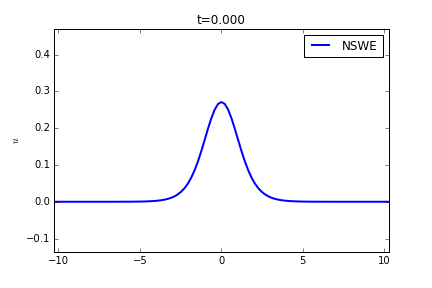
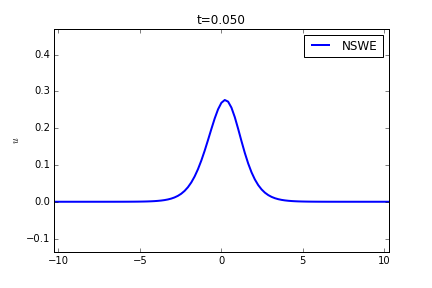
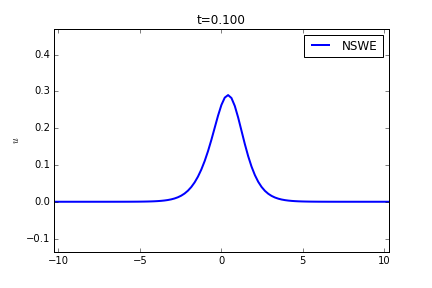
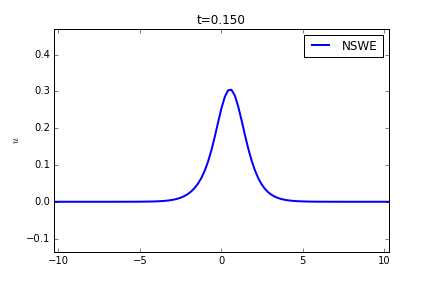
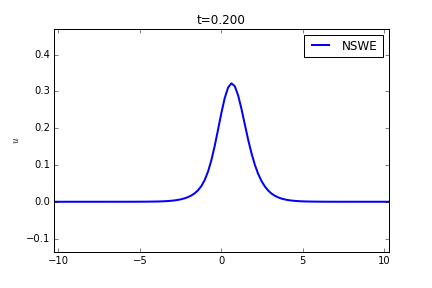
...
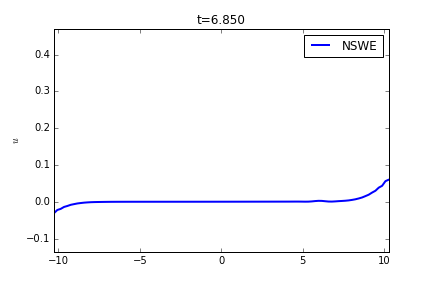
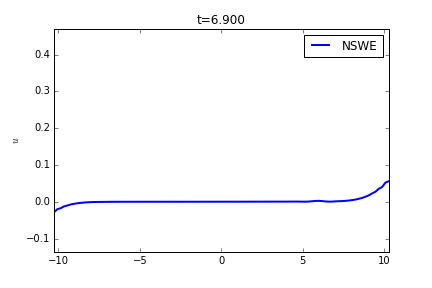
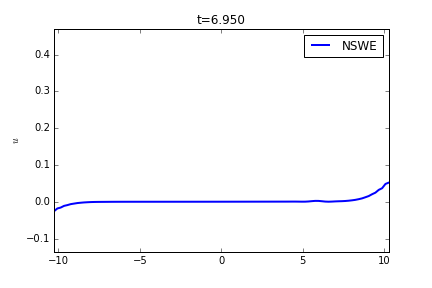
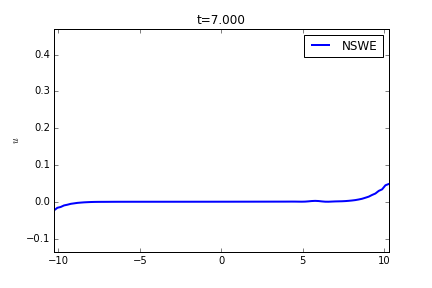
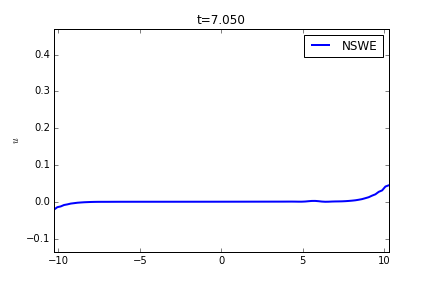

In [94]:
lb = ["NSWE"]
gF.plotAnimationNSolutions(1,xM,np.array([uallM]),tallM,xmin,xmax,umin,umax,lb,ylabel=r'$u$')

*** Plotting animation ...



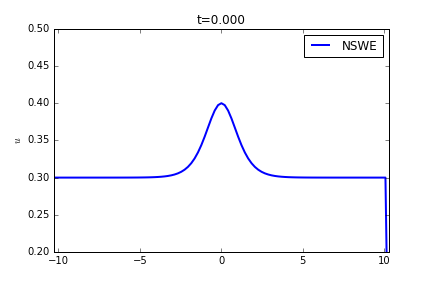
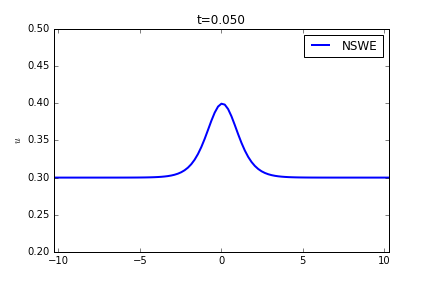
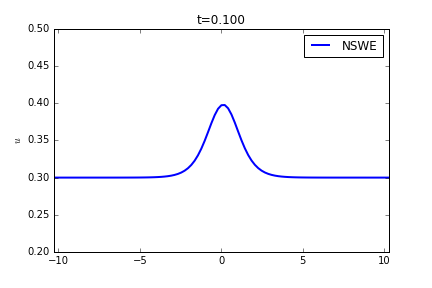
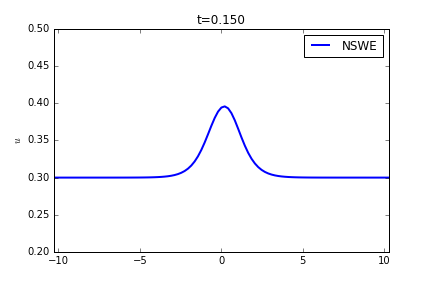
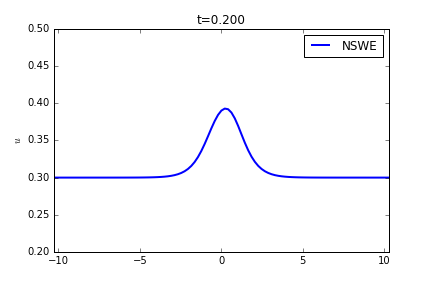
...
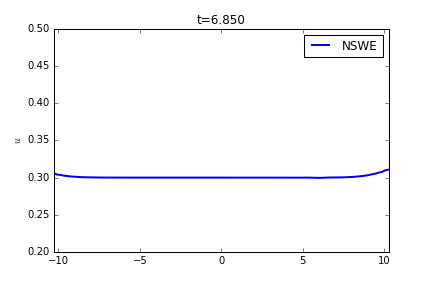
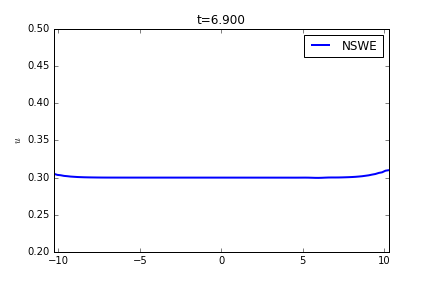
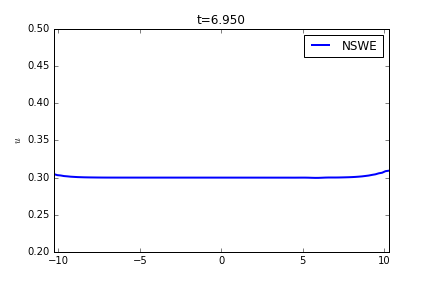
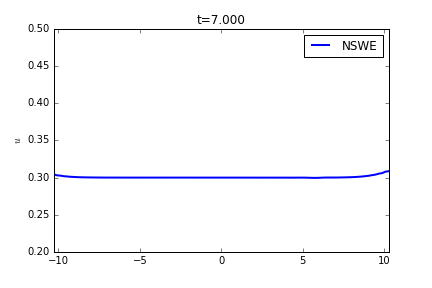
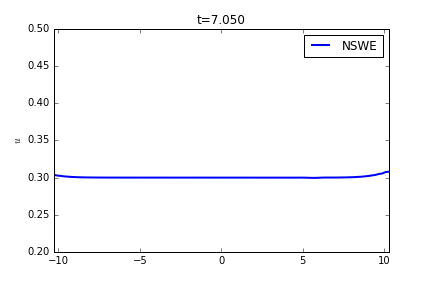

In [95]:
lb = ["NSWE"]
gF.plotAnimationNSolutions(1,xM,np.array([hallM]),tallM,xmin,xmax,0.2,0.5,lb,ylabel=r'$u$')

## DDM with overlapping 

### Only NSWE

In [289]:
## DDM

a0 = 0.3/1.
a1 = 0.1/1.
k = 0.99
g = 9.81/1.
t0 = 0.0
t = t0
tmax = 7.

lam, h0 = cnoidal.WaveLengthDepth(k,a0,a1)

L = 2*lam
xmin = -L
xmax = L
nx = 100

#x,dx = serre.discretizeSpace(xmin,xmax,nx)

#h,u = cnoidal.analyticalSolution(x,t,k,a0,a1)

dx1 = (xmax-xmin)/(nx)

x,dx = serre.discretizeSpace(xmin-3.*dx1,xmax+3.*dx1,nx+6)
dx = np.diff(x)[0]

Nddm = x.size/2
print(x.size)
print(x[Nddm:Nddm+3])

h,u = cnoidal.analyticalSolutionSolitary(x[3:-3],t,a0,a1)



h = serre.extend2GhostCells(h,3)
u = serre.extend2GhostCells(u,3)

print(x[Nddm],Nddm)
#overlapping size
ov = 0  ## ov = 0: 1 cell overlapped
configDDM = 2
if configDDM == 1:
    x1 = x[0:Nddm+3] ## (0:Nddm+1) + 3 gc 
    x2 = x[Nddm-3:] ## 3gc + (Nddm:)
    h1 = h[0:Nddm+3]
    h2 = h[Nddm-3:]
    u1 = u[0:Nddm+3]
    u2 = u[Nddm-3:]
elif configDDM == 2:
    x1 = x[0:Nddm+4+ov] ## (0:Nddm+1) + 3 gc + ov
    x2 = x[Nddm-3-ov:] ## ov + 3gc + (Nddm:)
    h1 = h[0:Nddm+4+ov]
    h2 = h[Nddm-3-ov:]
    u1 = u[0:Nddm+4+ov]
    u2 = u[Nddm-3-ov:]

## TBC for dispersive equation
## in right domain

print(x1[-3]-x2[4+2*ov],x2[0]-x1[-7-2*ov])



hall1,uall1,tall1,hall2,uall2,tall2 = DDM_NSWE(x1,h1,u1,x2,h2,u2,t0,tmax,DDM_BCs,None,None,dx,nx+6,
             vardt = True, dt = 0.05, fvsolver=fluxes,
             ghostcells = 3, externalBC="open",coupleSerre=False,nitermax=20,configDDM=configDDM,ov=ov,uref=uallM,
                                              href = hallM,xref=x,debug=True)

umin = np.amin(uall1)
umax = np.amax(uall1)
hmin = np.amin(hall1)
hmax = np.amax(hall1)

### remove ghost cells for Printing
x1P = x1[3:-3]
x2P = x2[3:-3]
uall1P = uall1[3:-3,:]
uall2P = uall2[3:-3,:]
hall1P = hall1[3:-3,:]
hall2P = hall2[3:-3,:]

106
[-0.          0.20551125  0.41102251]
(-2.4868995751603507e-14, 53)
(0.0, 0.0)
('t = ', 0.05)
53
Stencils around the interface point (href,h1,h2):
('g-3', 'g-2', 'g-1', 'Int', 'g1', 'g2', 'g3')
[ 0.37635242  0.38735409  0.39547768  0.39931022  0.39812313  0.39214247
  0.38246471]
[ 0.37955508  0.39014238  0.39740609  0.4         0.39812313  0.39214247
  0.38246471]
[ 0.37635242  0.38735409  0.39547768  0.4         0.39740609  0.39014238
  0.37955508]

**********
Debugging
**********

Verification of the interface position [M,Om1,Om2]:
(-2.4868995751603507e-14, -2.4868995751603507e-14, -2.4868995751603507e-14)

Verification of the solution in ghost cells (h1,href):
('Int', 'g1', 'g2', 'g3')
[ 0.39910233  0.39740609  0.39014238  0.37955508]
[ 0.39931022  0.39812313  0.39214247  0.38246471]

Verification of the solution in the first cells (h1,href):
('-3', '-2', '-1', 'Int')
[ 0.37635223  0.38735293  0.395515    0.39910233]
[ 0.37635242  0.38735409  0.39547768  0.39931022]

Verificati

/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:8: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:9: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:182: RuntimeWarning: invalid value encountered in divide
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:183: RuntimeWarning: invalid value encountered in divide


[ 0.373005    0.38396446  0.39252219  0.39703122  0.39572474  0.39311013
  0.38659766]
[ 0.36959087  0.3801529   0.38870876  0.39636506  0.39730828  0.39321305
  0.3848994 ]

**********
Debugging
**********

Verification of the interface position [M,Om1,Om2]:
(-2.4868995751603507e-14, -2.4868995751603507e-14, -2.4868995751603507e-14)

Verification of the solution in ghost cells (h1,href):
('Int', 'g1', 'g2', 'g3')
[ 0.39391815  0.39755323  0.39317407  0.38488365]
[ 0.39415882  0.39572474  0.39311013  0.38659766]

Verification of the solution in the first cells (h1,href):
('-3', '-2', '-1', 'Int')
[ 0.36960661  0.38014613  0.38861239  0.39391815]
[ 0.36959087  0.3801529   0.38870876  0.39415882]

Verification of the solution in ghost cells (h2,href):
('g-3', 'g-2', 'g-1', 'Int')
[ 0.37299953  0.38396752  0.39250858  0.39280726]
[ 0.36959087  0.3801529   0.38870876  0.39415882]

Verification of the solution in the first cells (h2,href):
('Int', '1', '2', '3')
[ 0.39280726  0.39509002  0.

 *** Plotting animation ...



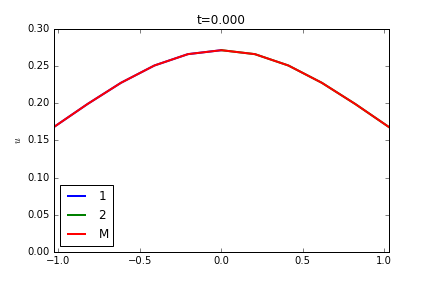
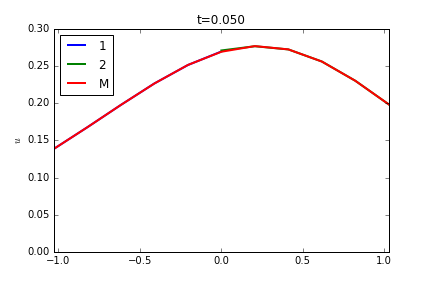
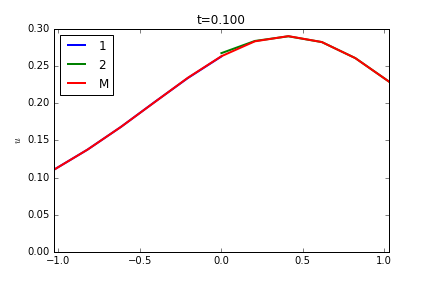
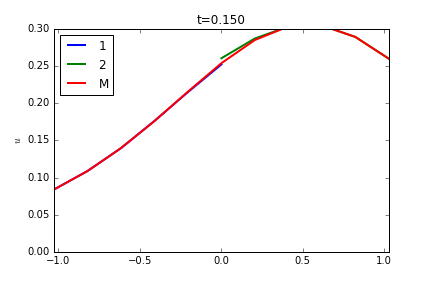
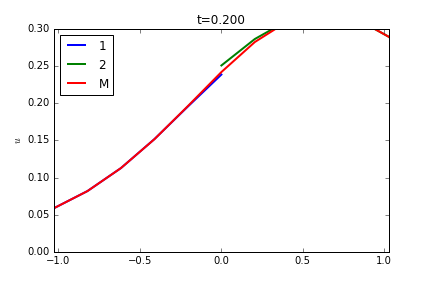
...
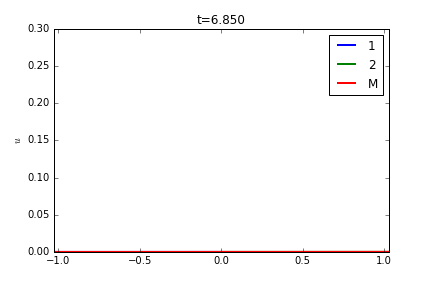
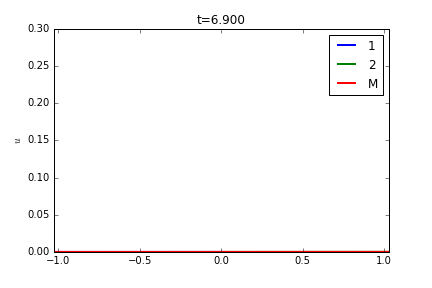
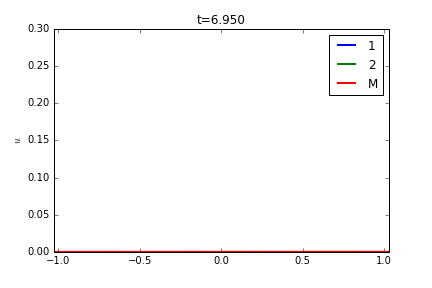
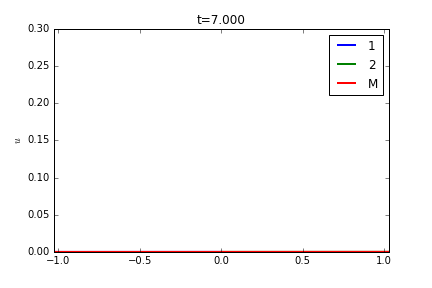
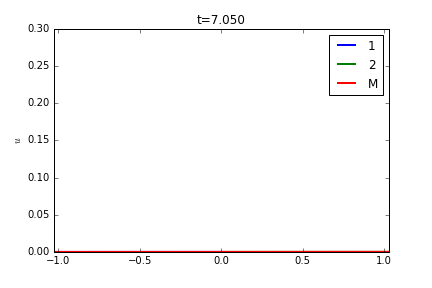

In [249]:
lb = ["1","2","M"]
gF.plotAnimationNSolutionsDiffDomain(3,np.array([x1P,x2P,xM]),np.array([uall1P,uall2P,uallM]),tall1,-5*dx,5*dx,0.,0.3,lb,ylabel=r'$u$')

*** Plotting animation ...



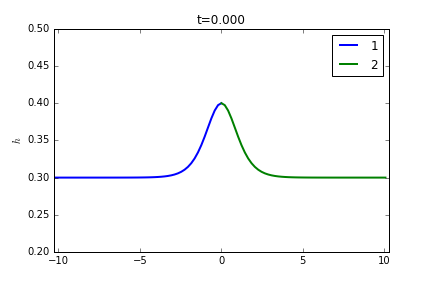
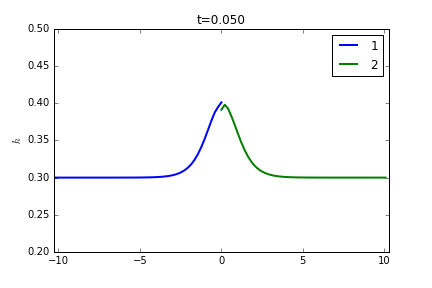
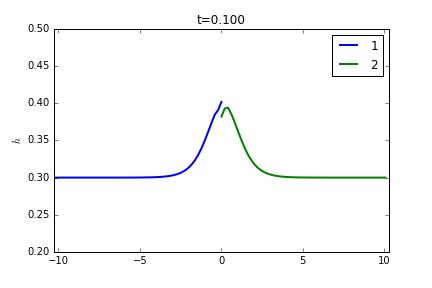
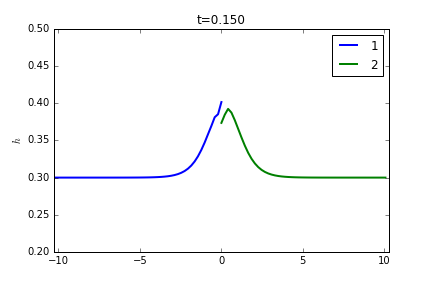
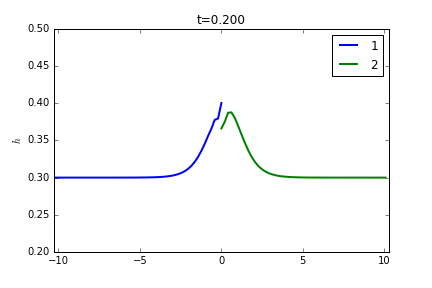
...
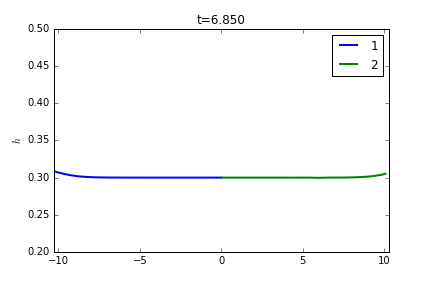
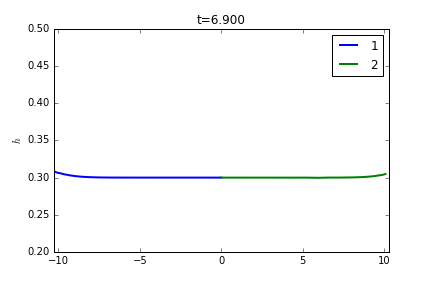
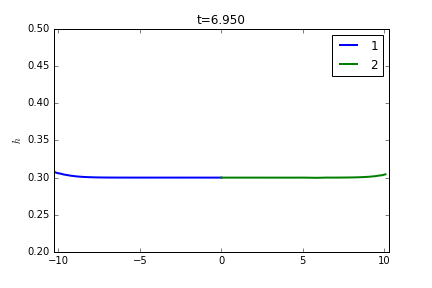
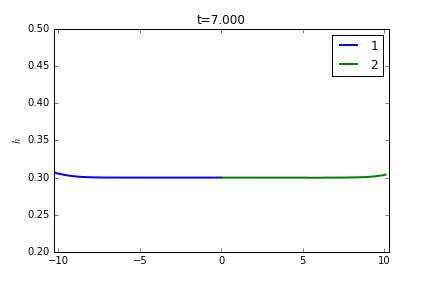
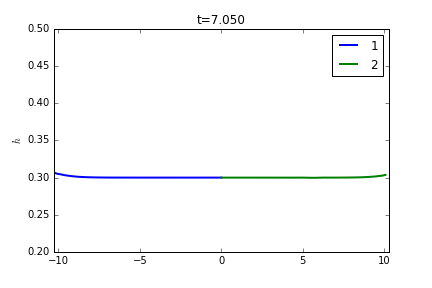

In [219]:
lb = ["1","2","M"]
gF.plotAnimationNSolutionsDiffDomain(2,np.array([x1P,x2P,xM]),np.array([hall1P,hall2P,hallM]),tall1,xmin,xmax,0.2,0.5,lb,ylabel=r'$h$')

In [390]:
print(x1.size,x2.size)
print(x1[-4:])
print(x2[0:4])
print(x[Nddm])

(57, 55)
[-0.          0.20551125  0.41102251  0.61653376]
[-0.41102251 -0.20551125 -0.          0.20551125]
-2.48689957516e-14


### NSWE + dispersive in the left

In [173]:
## DDM

a0 = 0.3
a1 = 0.1
k = 0.99
g = 9.81
t0 = 0.0
t = t0
tmax = 7.

lam, h0 = cnoidal.WaveLengthDepth(k,a0,a1)

L = 2*lam
xmin = -L
xmax = L
nx = 100

#x,dx = serre.discretizeSpace(xmin,xmax,nx)

#h,u = cnoidal.analyticalSolution(x,t,k,a0,a1)

dx1 = (xmax-xmin)/(nx)

x,dx = serre.discretizeSpace(xmin-3.*dx1,xmax+3.*dx1,nx+6)
dx = np.diff(x)[0]

Nddm = x.size/2
print(x.size)
print(x[Nddm:Nddm+3])

h,u = cnoidal.analyticalSolutionSolitary(x[3:-3],t,a0,a1)


h = serre.extend2GhostCells(h,3)
u = serre.extend2GhostCells(u,3)

ov = 30
configDDM = 2
if configDDM == 1:
    x1 = x[0:Nddm+3] ## (0:Nddm+1) + 3 gc 
    x2 = x[Nddm-3:] ## 3gc + (Nddm:)
    h1 = h[0:Nddm+3]
    h2 = h[Nddm-3:]
    u1 = u[0:Nddm+3]
    u2 = u[Nddm-3:]
elif configDDM == 2:
    x1 = x[0:Nddm+4+ov] ## (0:Nddm+1) + 3 gc + ov
    x2 = x[Nddm-3-ov:] ## ov + 3gc + (Nddm:)
    h1 = h[0:Nddm+4+ov]
    h2 = h[Nddm-3-ov:]
    u1 = u[0:Nddm+4+ov]
    u2 = u[Nddm-3-ov:]


serreDomain = 1
if serreDomain == 1:
    BCconfig = np.array([[0,"Robin",0.,0.,1.],
                                 [1,"Robin",0.,1.,0.],
                                 [-1,"Robin",0.,0.,1.]])
else :
    BCconfig = np.array([[0,"Robin",0.,0.,1.],
                                 [-2,"Robin",0.,1.,0.],
                                 [-1,"Robin",0.,0.,1.]])
    
hall1,uall1,tall1,hall2,uall2,tall2 = DDM_NSWE(x1,h1,u1,x2,h2,u2,t0,tmax,DDM_BCs,None,None,dx,nx,
             vardt = True, dt = 0.05, fvsolver=fluxes,
             ghostcells = 3, externalBC="open",coupleSerre=True,serreDomain=serreDomain,dispersiveBC=BCconfig,
             nitermax=20,configDDM=configDDM,ov=ov)

umin = np.amin(uall1)
umax = np.amax(uall1)
hmin = np.amin(hall1)
hmax = np.amax(hall1)

### remove ghost cells for Printing
x1P = x1[3:-3]
x2P = x2[3:-3]
uall1P = uall1[3:-3,:]
uall2P = uall2[3:-3,:]
hall1P = hall1[3:-3,:]
hall2P = hall2[3:-3,:]

106
[-0.          0.20551125  0.41102251]
('t = ', 0.05)
('Int 1: ', 1, 6.2426289599487649e-07, 2.447213551803884e-07, 4.0300583159513792e-07, 8.4551996049064826e-07)
('Int 2: ', 1, 1.493456210410819e-06, 3.4085833316988001e-07, 1.1852779021603865e-06, 1.8016345187943372e-06)
('Int 1: ', 2, 6.2583498535172298e-07, 2.3373496060852261e-07, 4.145108374320472e-07, 8.3715913334891923e-07)
('Int 2: ', 2, 1.3573265279487166e-06, 3.1464079153220581e-07, 1.0728519813651971e-06, 1.6418010745367084e-06)
('Int 1: ', 3, 6.2583498535172298e-07, 2.3373496060852261e-07, 4.145108374320472e-07, 8.3715913334891923e-07)
('Int 2: ', 3, 1.3573265279487166e-06, 3.1464079153220581e-07, 1.0728519813651971e-06, 1.6418010745367084e-06)
('t = ', 0.1)
('Int 1: ', 1, 3.0605920759628437e-07, 9.1899349075053038e-08, 2.2297235691137729e-07, 3.8914605837714333e-07)
('Int 2: ', 1, 1.2172134084967784e-06, 4.6772761552738018e-08, 1.1749249108072846e-06, 1.2595019062144885e-06)
('Int 1: ', 2, 3.8677786632436472e-07, 5.1971

/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:8: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:9: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:117: RuntimeWarning: invalid value encountered in divide
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:118: RuntimeWarning: invalid value encountered in divide


('Int 1: ', 3, 3.8677786632436472e-07, 5.1971557357699538e-07, 8.3100894276988413e-08, 8.5665662685752153e-07)
('Int 2: ', 3, 1.1164523321712994e-06, 5.4549783057300516e-07, 6.2325299221566155e-07, 1.6096516720631726e-06)
('t = ', 0.15000000000000002)
('Int 1: ', 1, 7.5696664109339991e-07, 5.5874264270894258e-08, 7.0645117389300793e-07, 8.0748210840031476e-07)
('Int 2: ', 1, 1.0062954400862445e-06, 1.7424945952804194e-07, 1.1638392920509943e-06, 8.4875158812280915e-07)
('Int 1: ', 2, 9.0703039201043808e-07, 9.615901427895146e-07, 3.7663839380641662e-08, 1.7763969446527028e-06)
('Int 2: ', 2, 8.5679430306254595e-07, 7.1510438198751913e-07, 2.1024796648116961e-07, 1.5033406396414151e-06)
('Int 1: ', 3, 9.0703039201043808e-07, 9.615901427895146e-07, 3.7663839380641662e-08, 1.7763969446527028e-06)
('Int 2: ', 3, 8.5679430306254595e-07, 7.1510438198751913e-07, 2.1024796648116961e-07, 1.5033406396414151e-06)
('t = ', 0.2)
('Int 1: ', 1, 1.8293092232880468e-06, 8.5854275522212475e-08, 1.90692

*** Plotting animation ...



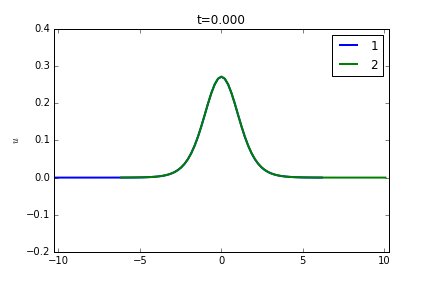
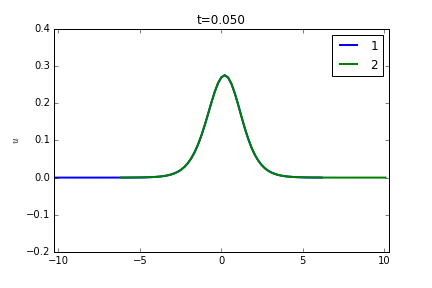
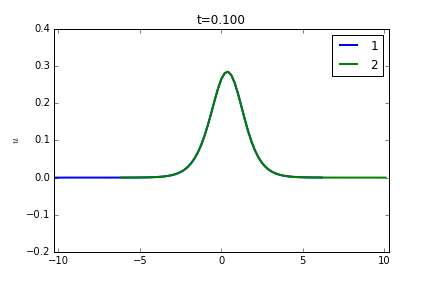
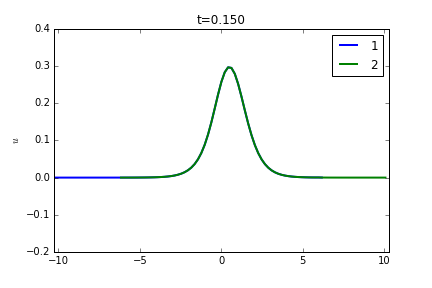
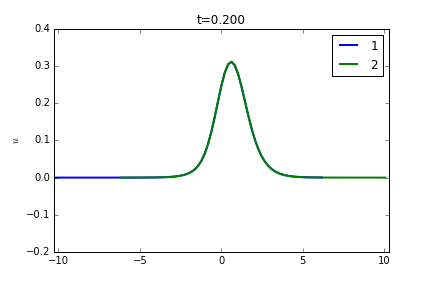
...
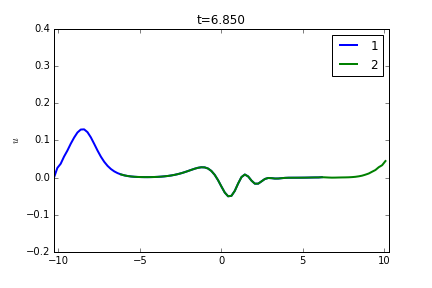
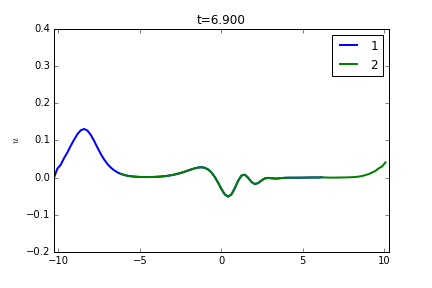
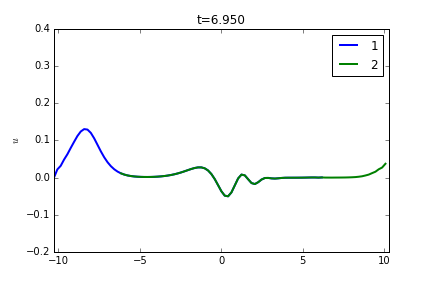
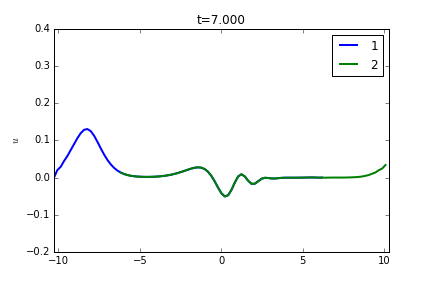
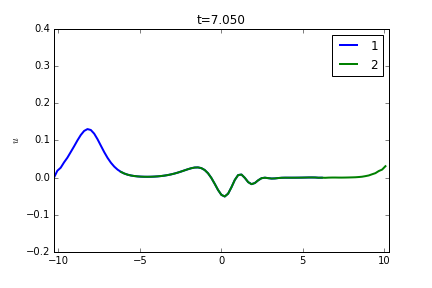

In [174]:
lb = ["1","2","M"]
gF.plotAnimationNSolutionsDiffDomain(2,np.array([x1P,x2P,xM]),np.array([uall1P,uall2P,uallM]),tall1,xmin,xmax,-0.2,0.4,lb,ylabel=r'$u$')

*** Plotting animation ...



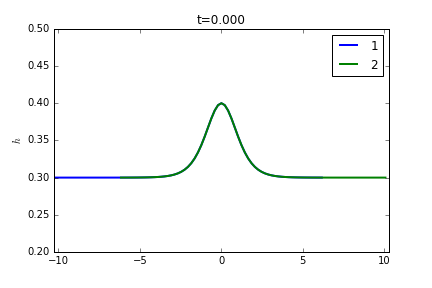
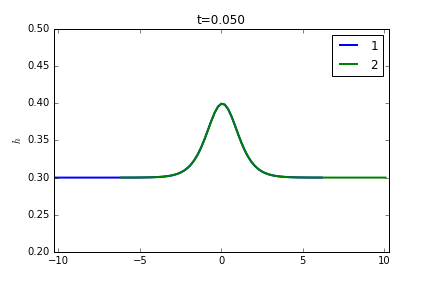
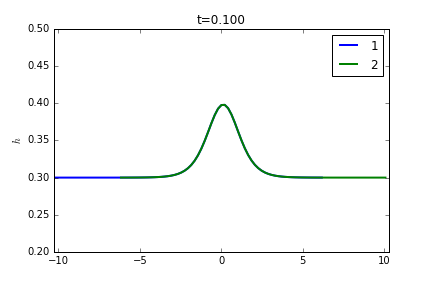
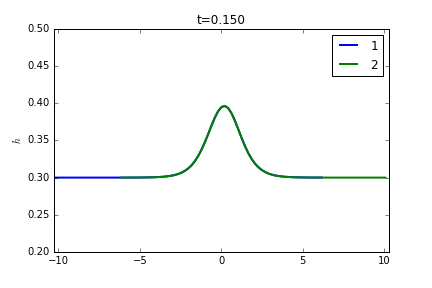
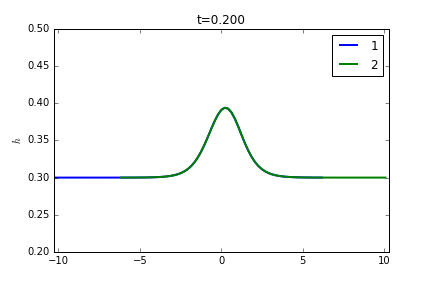
...
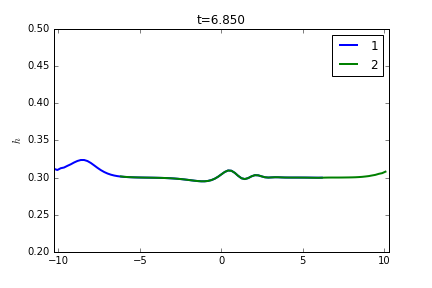
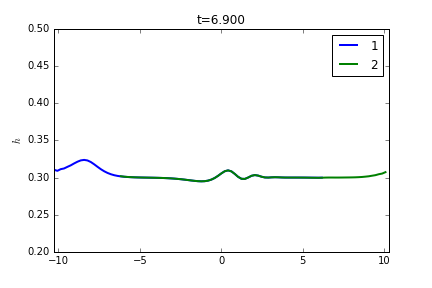
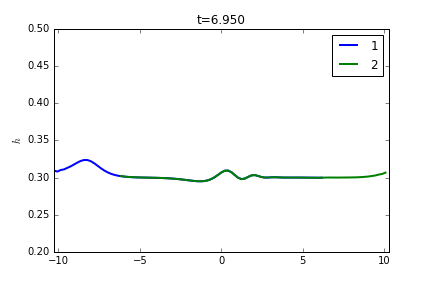
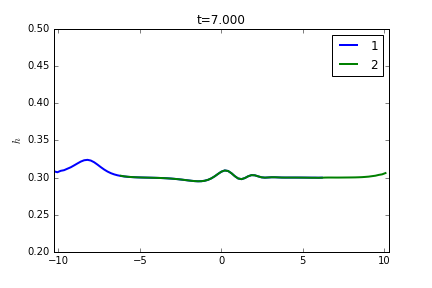
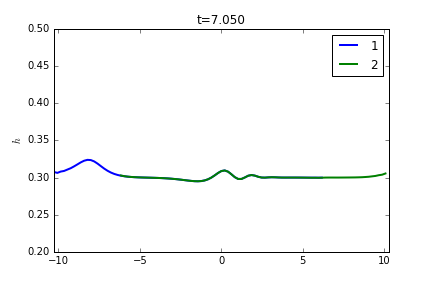

In [175]:
lb = ["1","2","M"]
gF.plotAnimationNSolutionsDiffDomain(2,np.array([x1P,x2P,xM]),np.array([hall1P,hall2P,hallM]),tall1,xmin,xmax,0.2,0.5,lb,ylabel=r'$h$')

### NSWE + dispersive in the right

In [179]:
## DDM

a0 = 0.3
a1 = 0.1
k = 0.99
g = 9.81
t0 = 0.0
t = t0
tmax = 7.

lam, h0 = cnoidal.WaveLengthDepth(k,a0,a1)

L = 2*lam
xmin = -L
xmax = L
nx = 100

#x,dx = serre.discretizeSpace(xmin,xmax,nx)

#h,u = cnoidal.analyticalSolution(x,t,k,a0,a1)

dx1 = (xmax-xmin)/(nx)

x,dx = serre.discretizeSpace(xmin-3.*dx1,xmax+3.*dx1,nx+6)
dx = np.diff(x)[0]

Nddm = x.size/2
print(x.size)
print(x[Nddm:Nddm+3])

h,u = cnoidal.analyticalSolutionSolitary(x[3:-3],t,a0,a1)


h = serre.extend2GhostCells(h,3)
u = serre.extend2GhostCells(u,3)

ov = 30
configDDM = 2
if configDDM == 1:
    x1 = x[0:Nddm+3] ## (0:Nddm+1) + 3 gc 
    x2 = x[Nddm-3:] ## 3gc + (Nddm:)
    h1 = h[0:Nddm+3]
    h2 = h[Nddm-3:]
    u1 = u[0:Nddm+3]
    u2 = u[Nddm-3:]
elif configDDM == 2:
    x1 = x[0:Nddm+4+ov] ## (0:Nddm+1) + 3 gc + ov
    x2 = x[Nddm-3-ov:] ## ov + 3gc + (Nddm:)
    h1 = h[0:Nddm+4+ov]
    h2 = h[Nddm-3-ov:]
    u1 = u[0:Nddm+4+ov]
    u2 = u[Nddm-3-ov:]


serreDomain = 2
if serreDomain == 1:
    BCconfig = np.array([[0,"Robin",0.,0.,1.],
                                 [1,"Robin",0.,1.,0.],
                                 [-1,"Robin",0.,0.,1.]])
else :
    BCconfig = np.array([[0,"Robin",0.,0.,1.],
                                 [-2,"Robin",0.,1.,0.],
                                 [-1,"Robin",0.,0.,1.]])
    
hall1,uall1,tall1,hall2,uall2,tall2 = DDM_NSWE(x1,h1,u1,x2,h2,u2,t0,tmax,DDM_BCs,None,None,dx,nx,
             vardt = True, dt = 0.05, fvsolver=fluxes,
             ghostcells = 3, externalBC="open",coupleSerre=True,serreDomain=serreDomain,dispersiveBC=BCconfig,
              nitermax = 20, configDDM = configDDM,ov=ov)

umin = np.amin(uall1)
umax = np.amax(uall1)
hmin = np.amin(hall1)
hmax = np.amax(hall1)

### remove ghost cells for Printing
x1P = x1[3:-3]
x2P = x2[3:-3]
uall1P = uall1[3:-3,:]
uall2P = uall2[3:-3,:]
hall1P = hall1[3:-3,:]
hall2P = hall2[3:-3,:]

106
[-0.          0.20551125  0.41102251]
('t = ', 0.05)
('Int 1: ', 1, 6.2426289599487649e-07, 2.447213551803884e-07, 4.0300583159513792e-07, 8.4551996049064826e-07)
('Int 2: ', 1, 1.493456210410819e-06, 3.4085833316988001e-07, 1.1852779021603865e-06, 1.8016345187943372e-06)
('Int 1: ', 2, 6.2583498535172298e-07, 2.3373496060852261e-07, 4.145108374320472e-07, 8.3715913334891923e-07)
('Int 2: ', 2, 1.3573265279487166e-06, 3.1464079153220581e-07, 1.0728519813651971e-06, 1.6418010745367084e-06)
('Int 1: ', 3, 6.2583498535172298e-07, 2.3373496060852261e-07, 4.145108374320472e-07, 8.3715913334891923e-07)
('Int 2: ', 3, 1.3573265279487166e-06, 3.1464079153220581e-07, 1.0728519813651971e-06, 1.6418010745367084e-06)
('t = ', 0.1)
('Int 1: ', 1, 9.0500176614562579e-07, 7.0395308915394139e-08, 8.4135635747273341e-07, 9.6864717491484953e-07)
('Int 2: ', 1, 1.6536193964463298e-06, 6.500655552743595e-08, 1.5948456421055468e-06, 1.7123931507212475e-06)
('Int 1: ', 2, 7.6855259645541418e-07, 4.40503

/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:8: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:9: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:117: RuntimeWarning: invalid value encountered in divide
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:118: RuntimeWarning: invalid value encountered in divide


('Int 1: ', 3, 7.6855259645541418e-07, 4.4050342645762797e-07, 3.7028695920593435e-07, 1.1668182336999067e-06)
('Int 2: ', 3, 1.381376153627024e-06, 6.1266482953570289e-07, 8.2745305718390227e-07, 1.935299250188649e-06)
('t = ', 0.15000000000000002)
('Int 1: ', 1, 1.1651663277359469e-06, 7.8624878441235779e-08, 1.2362518262420963e-06, 1.0940808290449411e-06)
('Int 2: ', 1, 1.1654807974308431e-06, 6.2651471177677109e-08, 1.2221248867350099e-06, 1.1088367081191208e-06)
('Int 1: ', 2, 9.6525064339334399e-07, 6.3215895101942365e-07, 3.9370947446659699e-07, 1.5367918123621038e-06)
('Int 2: ', 2, 7.7760861544838916e-07, 9.8369395301611817e-07, 1.1176381009558867e-07, 1.6669810408709296e-06)
('Int 1: ', 3, 9.6525064339334399e-07, 6.3215895101942365e-07, 3.9370947446659699e-07, 1.5367918123621038e-06)
('Int 2: ', 3, 7.7760861544838916e-07, 9.8369395301611817e-07, 1.1176381009558867e-07, 1.6669810408709296e-06)
('t = ', 0.2)
('Int 1: ', 1, 1.4228847214571745e-06, 2.1096726438019076e-07, 1.61362

*** Plotting animation ...



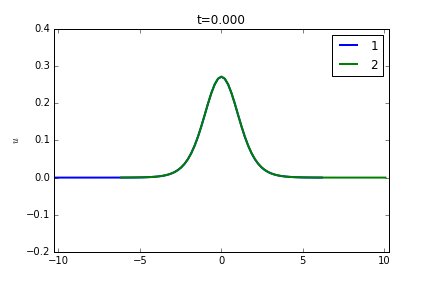
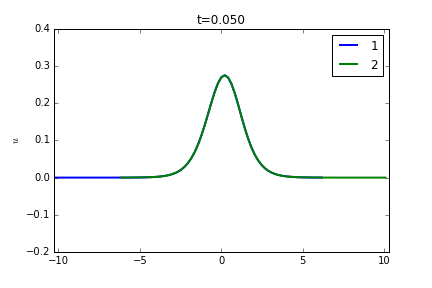
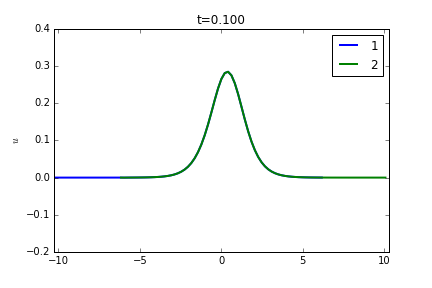
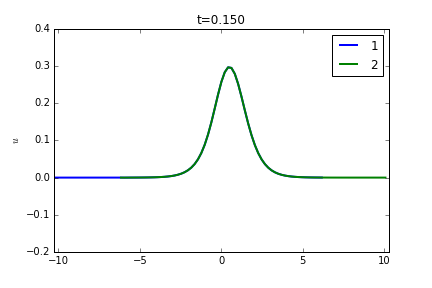
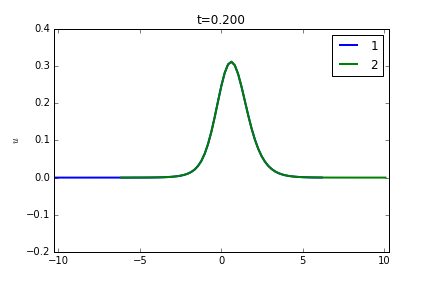
...
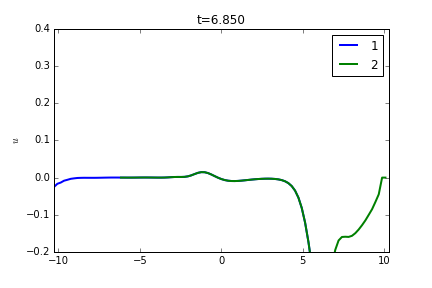
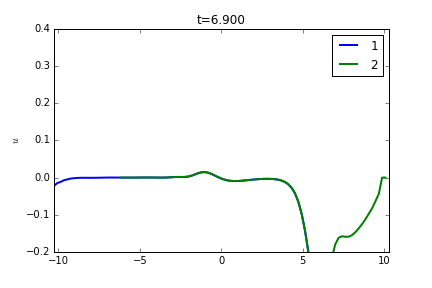
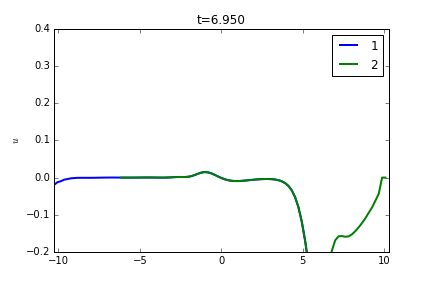
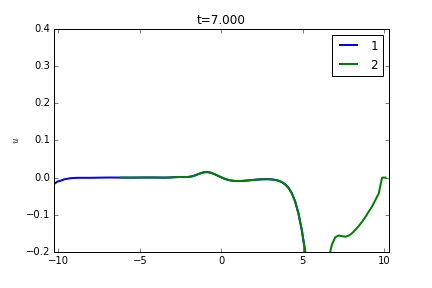
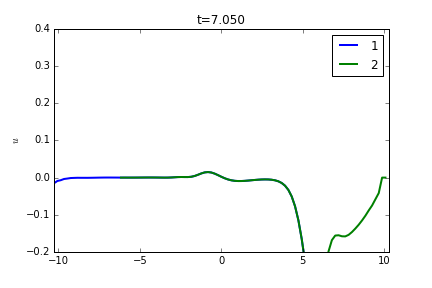

In [180]:
lb = ["1","2","M"]
gF.plotAnimationNSolutionsDiffDomain(2,np.array([x1P,x2P,xM]),np.array([uall1P,uall2P,uallM]),tall1,xmin,xmax,-0.2,0.4,lb,ylabel=r'$u$')

*** Plotting animation ...



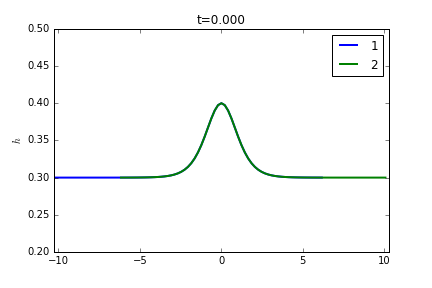
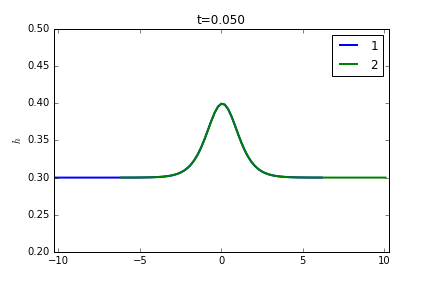
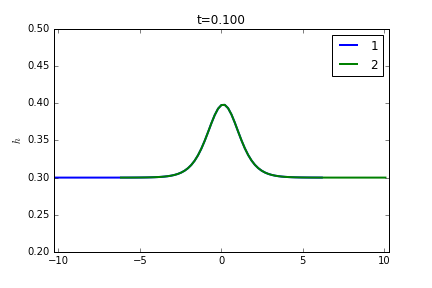
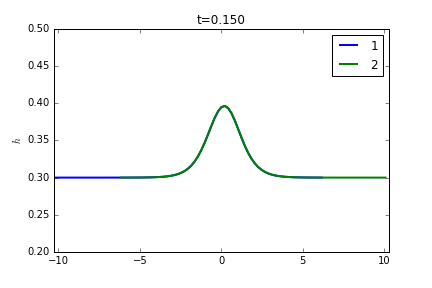
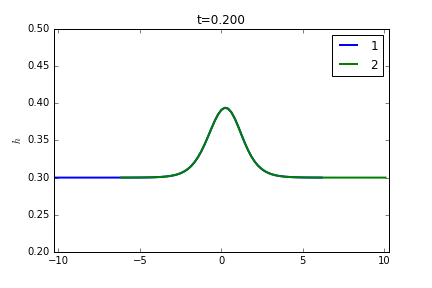
...
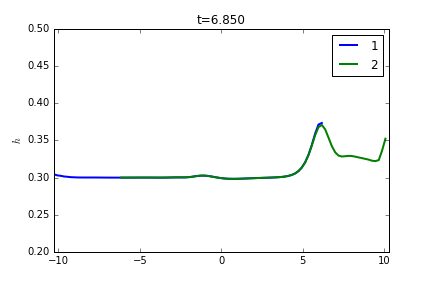
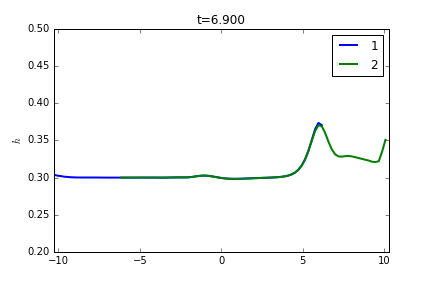
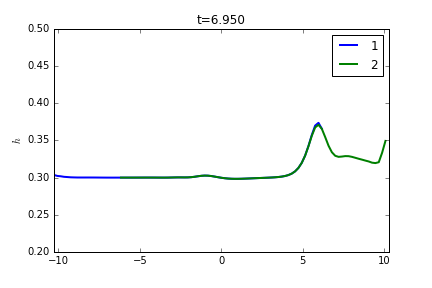
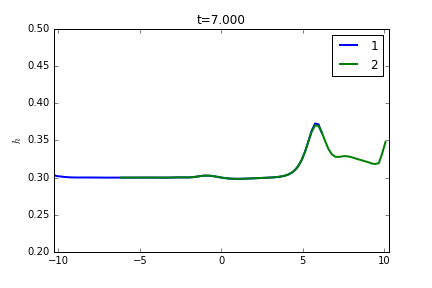
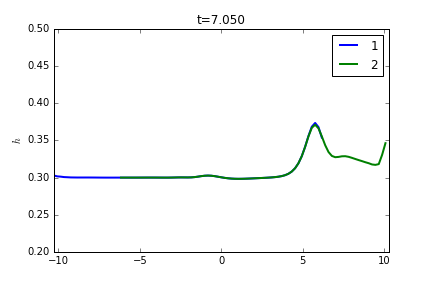

In [181]:
lb = ["1","2","M"]
gF.plotAnimationNSolutionsDiffDomain(2,np.array([x1P,x2P,xM]),np.array([hall1P,hall2P,hallM]),tall1,xmin,xmax,0.2,0.5,lb,ylabel=r'$h$')

## DDM without overlapping 

### Only NSWE

In [130]:
## DDM

a0 = 0.3
a1 = 0.1
k = 0.99
g = 9.81
t0 = 0.0
t = t0
tmax = 7.

lam, h0 = cnoidal.WaveLengthDepth(k,a0,a1)

L = 2*lam
xmin = -L
xmax = L
nx = 100

#x,dx = serre.discretizeSpace(xmin,xmax,nx)

#h,u = cnoidal.analyticalSolution(x,t,k,a0,a1)

dx1 = (xmax-xmin)/(nx)

x,dx = serre.discretizeSpace(xmin-3.*dx1,xmax+3.*dx1,nx+6)
dx = np.diff(x)[0]

Nddm = x.size/2
print(x.size)
print(x[Nddm:Nddm+3])

h,u = cnoidal.analyticalSolutionSolitary(x[3:-3],t,a0,a1)


h = serre.extend2GhostCells(h,3)
u = serre.extend2GhostCells(u,3)

configDDM = 1
if configDDM == 1:
    x1 = x[0:Nddm+3] ## (0:Nddm+1) + 3 gc 
    x2 = x[Nddm-3:] ## 3gc + (Nddm:)
    h1 = h[0:Nddm+3]
    h2 = h[Nddm-3:]
    u1 = u[0:Nddm+3]
    u2 = u[Nddm-3:]
elif configDDM == 2:
    x1 = x[0:Nddm+4] ## (0:Nddm+1) + 3 gc 
    x2 = x[Nddm-3:] ## 3gc + (Nddm:)
    h1 = h[0:Nddm+4]
    h2 = h[Nddm-3:]
    u1 = u[0:Nddm+4]
    u2 = u[Nddm-3:]

## TBC for dispersive equation
## in right domain

hall1,uall1,tall1,hall2,uall2,tall2 = DDM_NSWE(x1,h1,u1,x2,h2,u2,t0,tmax,DDM_BCs,None,None,dx,nx,
             vardt = True, dt = 0.05, fvsolver=fluxes,
             ghostcells = 3, externalBC="open",coupleSerre=False,nitermax=1,configDDM=configDDM)

umin = np.amin(uall1)
umax = np.amax(uall1)
hmin = np.amin(hall1)
hmax = np.amax(hall1)

### remove ghost cells for Printing
x1P = x1[3:-3]
x2P = x2[3:-3]
uall1P = uall1[3:-3,:]
uall2P = uall2[3:-3,:]
hall1P = hall1[3:-3,:]
hall2P = hall2[3:-3,:]

106
[-0.          0.20551125  0.41102251]
('t = ', 0.05)
('Int 1: ', 1, 0.019780773341662228, 0.0043445888765603069, 0.016368476324124914, 0.023193070359199486)
('Int 2: ', 1, 0.019780773341662228, 0.0043445888765603069, 0.016368476324124914, 0.023193070359199486)
('t = ', 0.1)
('Int 1: ', 1, 0.034739732176066601, 0.005990516556332981, 0.030020672407195914, 0.039458791944937177)
('Int 2: ', 1, 0.034739732176066601, 0.005990516556332981, 0.030020672407195914, 0.039458791944937177)
('t = ', 0.15000000000000002)
('Int 1: ', 1, 0.048225130074130623, 0.0072244692687283285, 0.042508792938202367, 0.053941467210058769)
('Int 2: ', 1, 0.048225130074130623, 0.0072244692687283285, 0.042508792938202367, 0.053941467210058769)
('t = ', 0.2)
('Int 1: ', 1, 0.0587110472468024, 0.0078610328882929847, 0.052455931077272533, 0.064966163416332323)
('Int 2: ', 1, 0.0587110472468024, 0.0078610328882929847, 0.052455931077272533, 0.064966163416332323)
('t = ', 0.25)
('Int 1: ', 1, 0.065531423147712209, 0.00789

/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:8: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:9: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:117: RuntimeWarning: invalid value encountered in divide
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:118: RuntimeWarning: invalid value encountered in divide


('Int 1: ', 1, 0.066834832987506976, 0.0055378207065223672, 0.062270033617939702, 0.071399632357074361)
('Int 2: ', 1, 0.066834832987506976, 0.0055378207065223672, 0.062270033617939702, 0.071399632357074361)
('t = ', 0.49999999999999994)
('Int 1: ', 1, 0.064663798250953003, 0.005095399555219815, 0.060434324270247697, 0.068893272231658309)
('Int 2: ', 1, 0.064663798250953003, 0.005095399555219815, 0.060434324270247697, 0.068893272231658309)
('t = ', 0.5499999999999999)
('Int 1: ', 1, 0.062329614206398612, 0.0047699941663620349, 0.058343531341057631, 0.066315697071739566)
('Int 2: ', 1, 0.062329614206398612, 0.0047699941663620349, 0.058343531341057631, 0.066315697071739566)
('t = ', 0.6)
('Int 1: ', 1, 0.059816188913729279, 0.0045020165963960967, 0.056029670379830976, 0.063602707447627638)
('Int 2: ', 1, 0.059816188913729279, 0.0045020165963960967, 0.056029670379830976, 0.063602707447627638)
('t = ', 0.65)
('Int 1: ', 1, 0.05703566888426953, 0.0042342477792854383, 0.053452334347965647, 0

*** Plotting animation ...



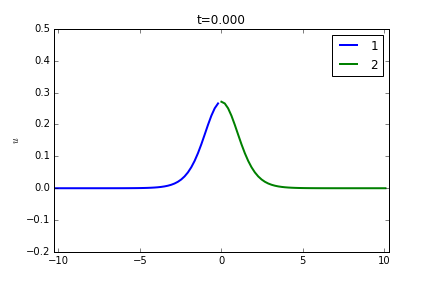
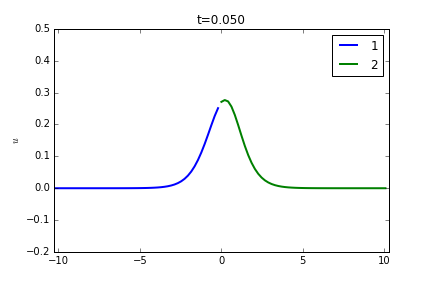
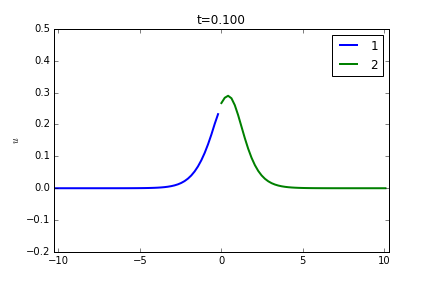
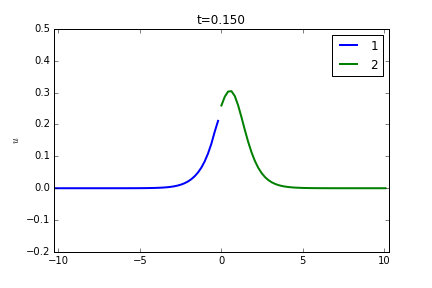
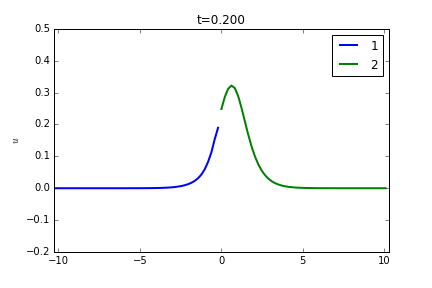
...
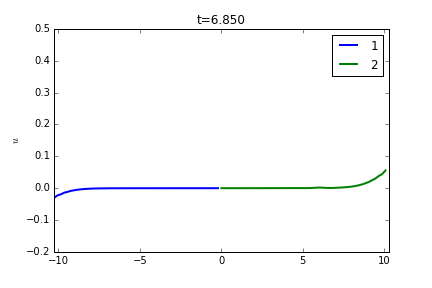
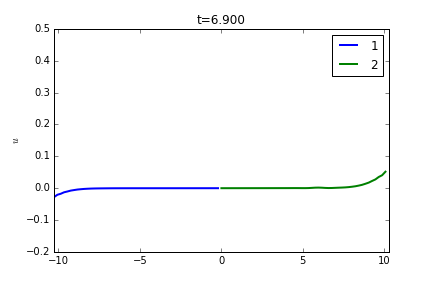
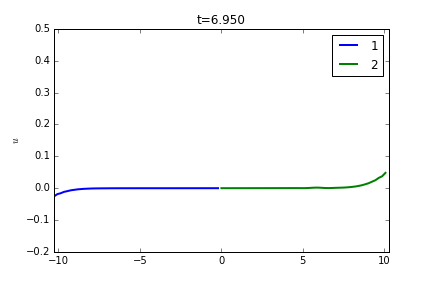
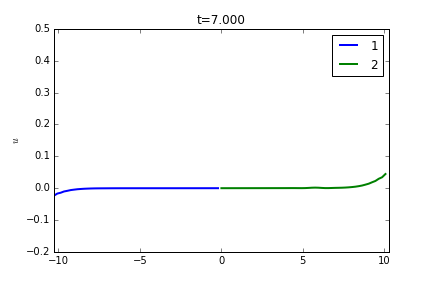
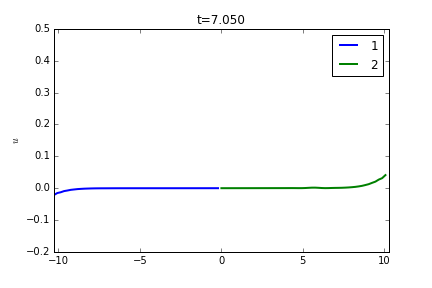

In [131]:
lb = ["1","2","M"]
gF.plotAnimationNSolutionsDiffDomain(2,np.array([x1P,x2P,xM]),np.array([uall1P,uall2P,uallM]),tall1,xmin,xmax,-0.2,0.5,lb,ylabel=r'$u$')

*** Plotting animation ...



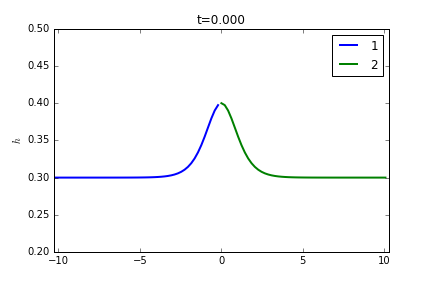
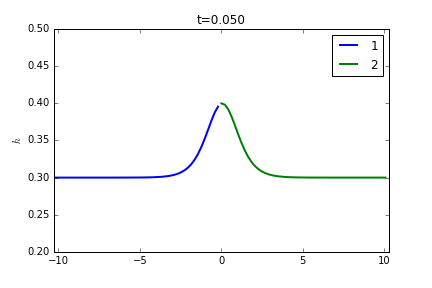
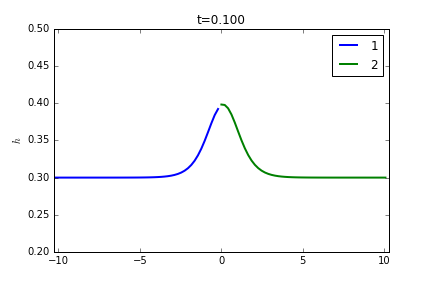
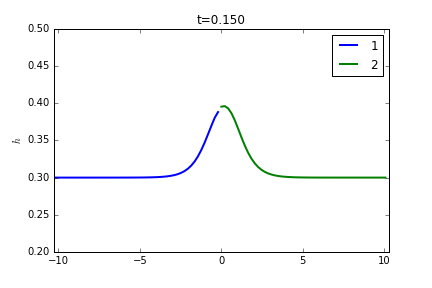
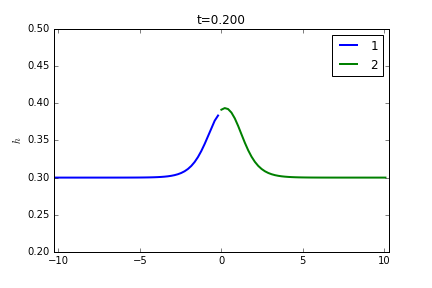
...
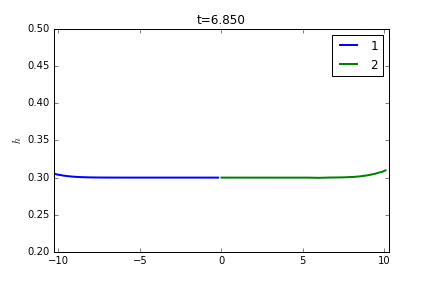
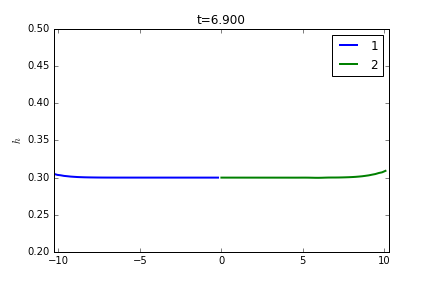
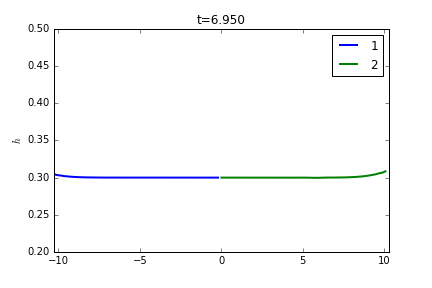
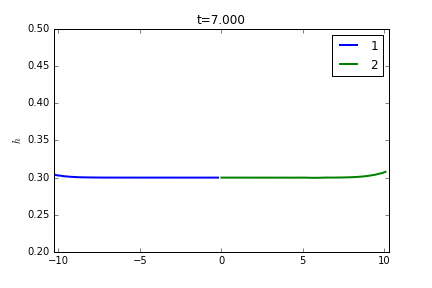
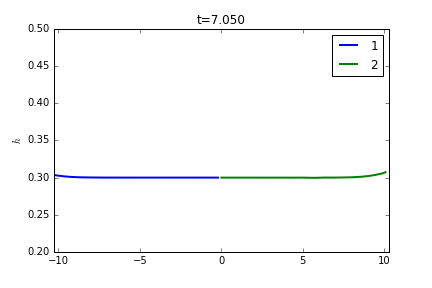

In [132]:
lb = ["1","2","M"]
gF.plotAnimationNSolutionsDiffDomain(2,np.array([x1P,x2P,xM]),np.array([hall1P,hall2P,hallM]),tall1,xmin,xmax,0.2,0.5,lb,ylabel=r'$h$')

In [409]:
print(x1.size,x2.size)
print(x1[-4:])
print(x2[0:4])
print(x[Nddm])

(56, 56)
[-0.20551125 -0.          0.20551125  0.41102251]
[-0.61653376 -0.41102251 -0.20551125 -0.        ]
-2.48689957516e-14


### NSWE + dispersive in the left

In [122]:
## DDM

a0 = 0.3
a1 = 0.1
k = 0.99
g = 9.81
t0 = 0.0
t = t0
tmax = 7.

lam, h0 = cnoidal.WaveLengthDepth(k,a0,a1)

L = 2*lam
xmin = -L
xmax = L
nx = 100

#x,dx = serre.discretizeSpace(xmin,xmax,nx)

#h,u = cnoidal.analyticalSolution(x,t,k,a0,a1)

dx1 = (xmax-xmin)/(nx)

x,dx = serre.discretizeSpace(xmin-3.*dx1,xmax+3.*dx1,nx+6)
dx = np.diff(x)[0]

Nddm = x.size/2
print(x.size)
print(x[Nddm:Nddm+3])

h,u = cnoidal.analyticalSolutionSolitary(x[3:-3],t,a0,a1)


h = serre.extend2GhostCells(h,3)
u = serre.extend2GhostCells(u,3)

configDDM = 1
if configDDM == 1:
    x1 = x[0:Nddm+3] ## (0:Nddm+1) + 3 gc 
    x2 = x[Nddm-3:] ## 3gc + (Nddm:)
    h1 = h[0:Nddm+3]
    h2 = h[Nddm-3:]
    u1 = u[0:Nddm+3]
    u2 = u[Nddm-3:]
elif configDDM == 2:
    x1 = x[0:Nddm+4] ## (0:Nddm+1) + 3 gc 
    x2 = x[Nddm-3:] ## 3gc + (Nddm:)
    h1 = h[0:Nddm+4]
    h2 = h[Nddm-3:]
    u1 = u[0:Nddm+4]
    u2 = u[Nddm-3:]


serreDomain = 1
if serreDomain == 1:
    BCconfig = np.array([[0,"Robin",0.,0.,1.],
                                 [1,"Robin",0.,1.,0.],
                                 [-1,"Robin",0.,0.,1.]])
else :
    BCconfig = np.array([[0,"Robin",0.,0.,1.],
                                 [-2,"Robin",0.,1.,0.],
                                 [-1,"Robin",0.,0.,1.]])
    
hall1,uall1,tall1,hall2,uall2,tall2 = DDM_NSWE(x1,h1,u1,x2,h2,u2,t0,tmax,DDM_BCs,None,None,dx,nx,
             vardt = True, dt = 0.05, fvsolver=fluxes,
             ghostcells = 3, externalBC="open",coupleSerre=True,serreDomain=serreDomain,dispersiveBC=BCconfig,
             nitermax=20,configDDM=configDDM)

umin = np.amin(uall1)
umax = np.amax(uall1)
hmin = np.amin(hall1)
hmax = np.amax(hall1)

### remove ghost cells for Printing
x1P = x1[3:-3]
x2P = x2[3:-3]
uall1P = uall1[3:-3,:]
uall2P = uall2[3:-3,:]
hall1P = hall1[3:-3,:]
hall2P = hall2[3:-3,:]

106
[-0.          0.20551125  0.41102251]
('t = ', 0.05)
('Int 1: ', 1, 0.019780773341662228, 0.0043445888765603069, 0.016368476324124914, 0.023193070359199486)
('Int 2: ', 1, 0.019780773341662228, 0.0043445888765603069, 0.016368476324124914, 0.023193070359199486)
('Int 1: ', 2, 0.015626893690195487, 0.0033205721253394826, 0.013017504718149497, 0.018236282662241532)
('Int 2: ', 2, 0.015626893690195487, 0.0033205721253394826, 0.013017504718149497, 0.018236282662241532)
('Int 1: ', 3, 0.01466953001260346, 0.0031796927589153312, 0.012171177565960589, 0.017167882459246275)
('Int 2: ', 3, 0.01466953001260346, 0.0031796927589153312, 0.012171177565960589, 0.017167882459246275)
('Int 1: ', 4, 0.01521524699925253, 0.0033040238039578895, 0.012619372841695509, 0.017811121156809495)
('Int 2: ', 4, 0.01521524699925253, 0.0033040238039578895, 0.012619372841695509, 0.017811121156809495)
('Int 1: ', 5, 0.015328795860120425, 0.0033229603605111624, 0.012717997910952794, 0.017939593809288001)
('Int 2: ',

/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:8: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:9: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:117: RuntimeWarning: invalid value encountered in divide
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:118: RuntimeWarning: invalid value encountered in divide


('Int 1: ', 7, 0.015244918438644339, 0.0033052504852051356, 0.012648020081117151, 0.017841816796171472)
('Int 2: ', 7, 0.015244918438644339, 0.0033052504852051356, 0.012648020081117151, 0.017841816796171472)
('Int 1: ', 8, 0.015253847063478709, 0.0033071330671852195, 0.012655472154721015, 0.017852221972236348)
('Int 2: ', 8, 0.015253847063478709, 0.0033071330671852195, 0.012655472154721015, 0.017852221972236348)
('Int 1: ', 9, 0.015255529976695215, 0.0033074511397445105, 0.012656904401440183, 0.017854155551950246)
('Int 2: ', 9, 0.015255529976695215, 0.0033074511397445105, 0.012656904401440183, 0.017854155551950246)
('Int 1: ', 10, 0.015254400140335245, 0.0033072172670825517, 0.012655957995620304, 0.01785284228505013)
('Int 2: ', 10, 0.015254400140335245, 0.0033072172670825517, 0.012655957995620304, 0.01785284228505013)
('Int 1: ', 11, 0.015254192203528139, 0.0033071767830132881, 0.012655781963302248, 0.017852602443753973)
('Int 2: ', 11, 0.015254192203528139, 0.0033071767830132881, 0.

*** Plotting animation ...



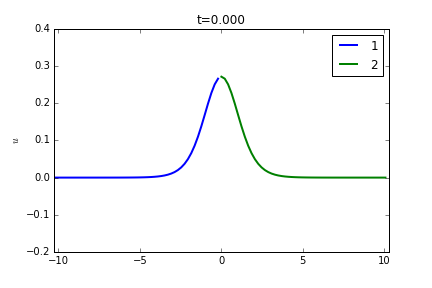
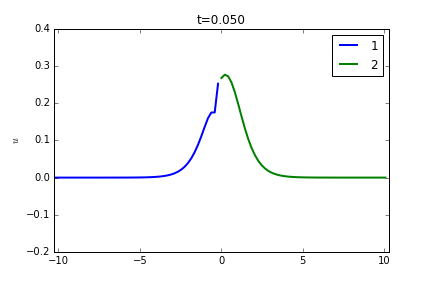
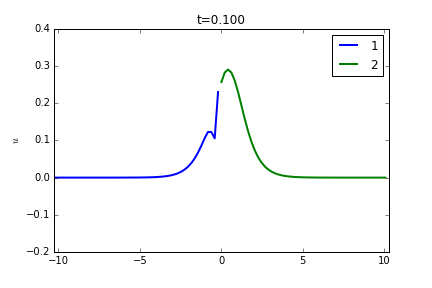
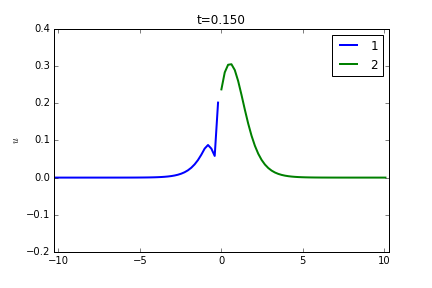
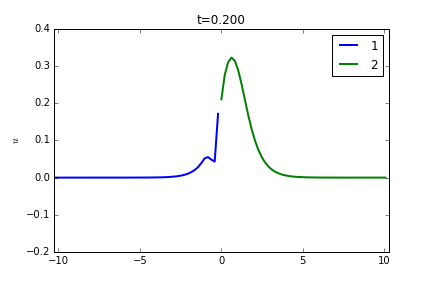
...
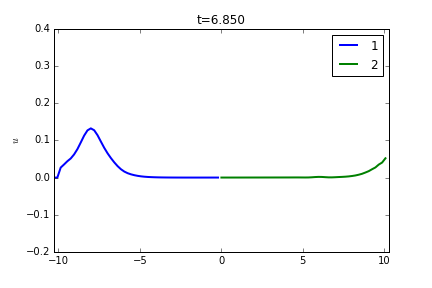
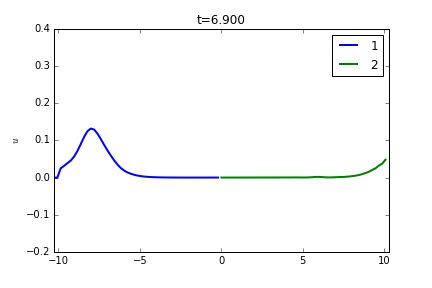
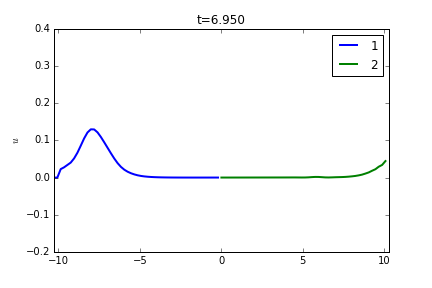
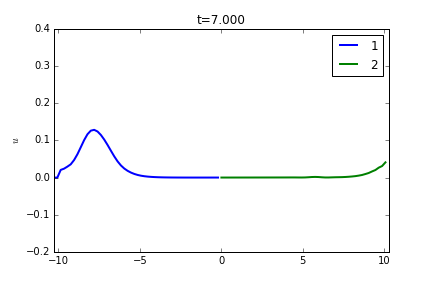
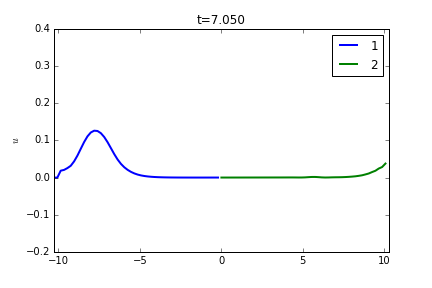

In [123]:
lb = ["1","2","M"]
gF.plotAnimationNSolutionsDiffDomain(2,np.array([x1P,x2P,xM]),np.array([uall1P,uall2P,uallM]),tall1,xmin,xmax,-0.2,0.4,lb,ylabel=r'$u$')

*** Plotting animation ...



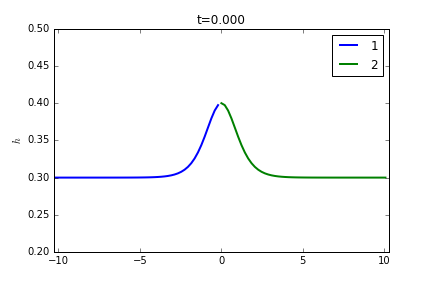
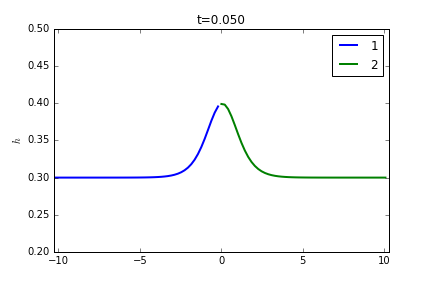
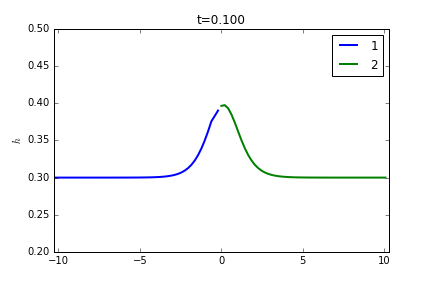
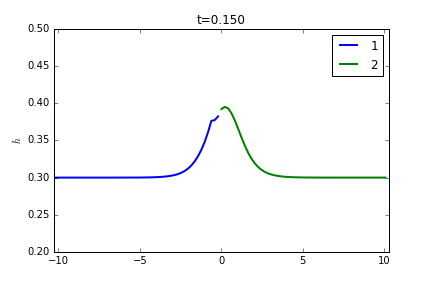
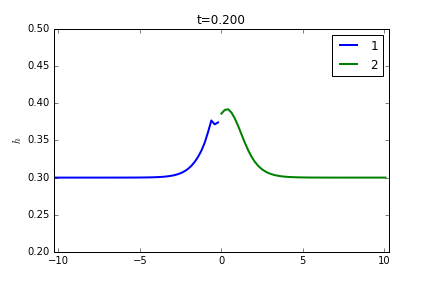
...
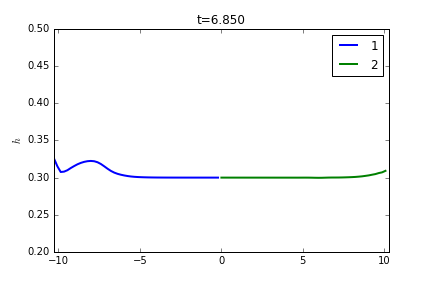
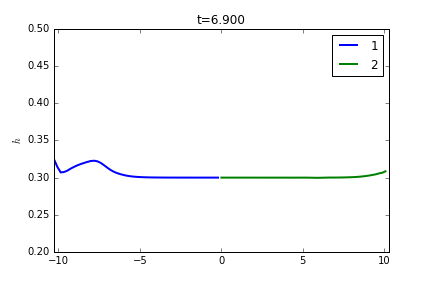
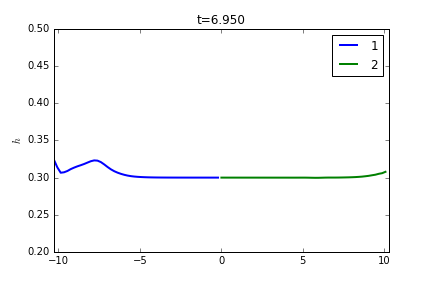
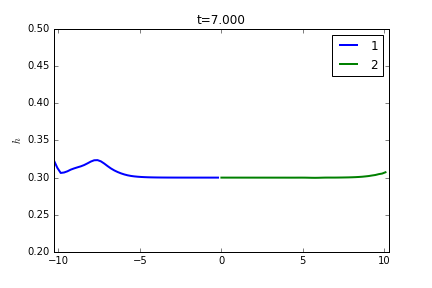
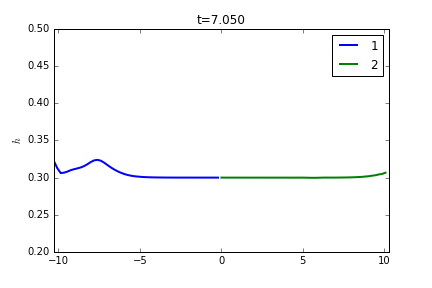

In [124]:
lb = ["1","2","M"]
gF.plotAnimationNSolutionsDiffDomain(2,np.array([x1P,x2P,xM]),np.array([hall1P,hall2P,hallM]),tall1,xmin,xmax,0.2,0.5,lb,ylabel=r'$h$')

### NSWE + dispersive in the right

In [410]:
## DDM

a0 = 0.3
a1 = 0.1
k = 0.99
g = 9.81
t0 = 0.0
t = t0
tmax = 7.

lam, h0 = cnoidal.WaveLengthDepth(k,a0,a1)

L = 2*lam
xmin = -L
xmax = L
nx = 100

#x,dx = serre.discretizeSpace(xmin,xmax,nx)

#h,u = cnoidal.analyticalSolution(x,t,k,a0,a1)

dx1 = (xmax-xmin)/(nx)

x,dx = serre.discretizeSpace(xmin-3.*dx1,xmax+3.*dx1,nx+6)
dx = np.diff(x)[0]

Nddm = x.size/2
print(x.size)
print(x[Nddm:Nddm+3])

h,u = cnoidal.analyticalSolutionSolitary(x[3:-3],t,a0,a1)


h = serre.extend2GhostCells(h,3)
u = serre.extend2GhostCells(u,3)

configDDM = 1
if configDDM == 1:
    x1 = x[0:Nddm+3] ## (0:Nddm+1) + 3 gc 
    x2 = x[Nddm-3:] ## 3gc + (Nddm:)
    h1 = h[0:Nddm+3]
    h2 = h[Nddm-3:]
    u1 = u[0:Nddm+3]
    u2 = u[Nddm-3:]
elif configDDM == 2:
    x1 = x[0:Nddm+4] ## (0:Nddm+1) + 3 gc 
    x2 = x[Nddm-3:] ## 3gc + (Nddm:)
    h1 = h[0:Nddm+4]
    h2 = h[Nddm-3:]
    u1 = u[0:Nddm+4]
    u2 = u[Nddm-3:]


serreDomain = 2
if serreDomain == 1:
    BCconfig = np.array([[0,"Robin",0.,0.,1.],
                                 [1,"Robin",0.,1.,0.],
                                 [-1,"Robin",0.,0.,1.]])
else :
    BCconfig = np.array([[0,"Robin",0.,0.,1.],
                                 [-2,"Robin",0.,1.,0.],
                                 [-1,"Robin",0.,0.,1.]])
    
hall1,uall1,tall1,hall2,uall2,tall2 = DDM_NSWE(x1,h1,u1,x2,h2,u2,t0,tmax,DDM_BCs,None,None,dx,nx,
             vardt = True, dt = 0.05, fvsolver=fluxes,
             ghostcells = 3, externalBC="open",coupleSerre=True,serreDomain=serreDomain,dispersiveBC=BCconfig,
              nitermax = 20, configDDM = configDDM)

umin = np.amin(uall1)
umax = np.amax(uall1)
hmin = np.amin(hall1)
hmax = np.amax(hall1)

### remove ghost cells for Printing
x1P = x1[3:-3]
x2P = x2[3:-3]
uall1P = uall1[3:-3,:]
uall2P = uall2[3:-3,:]
hall1P = hall1[3:-3,:]
hall2P = hall2[3:-3,:]

106
[-0.          0.20551125  0.41102251]
('t = ', 0.05)
(1, 0.0080117493749738838, 0.0091569787618857989, 0.076837887953195239, 0.08386423427223233)
(2, 0.00093623633285955612, 0.00093626928518787472, 0.0039085171717635411, 0.0039087541863682667)
(3, 0.00018497453785998701, 0.0001849694797031889, 0.001208948145680092, 0.001208938664294333)
(4, 0.00011432511951519661, 0.00011432614439054301, 0.00051124174372058962, 0.00051124860479072126)
(5, 2.4611033072080599e-05, 2.4610502710123105e-05, 0.00014429447799803408, 0.00014429299868575705)
(6, 1.4050233727298218e-05, 1.4050367689922427e-05, 6.5463794185729245e-05, 6.546461617247087e-05)


/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:8: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:9: DeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:112: RuntimeWarning: invalid value encountered in divide
/Users/joaocaldas/Softwares/anaconda2/lib/python2.7/site-packages/ipykernel/__main__.py:113: RuntimeWarning: invalid value encountered in divide


(7, 3.197818322959958e-06, 3.197759353790997e-06, 1.7527350661319484e-05, 1.7527139002739295e-05)
(8, 1.739502407719507e-06, 1.739519662957219e-06, 8.314600008052273e-06, 8.314700289493859e-06)
(9, 4.0963700901229067e-07, 4.0963015263112538e-07, 2.1534879596043909e-06, 2.153459212085896e-06)
(10, 2.1636256833066076e-07, 2.1636476805544299e-07, 1.050724624009464e-06, 1.0507369842609428e-06)
(11, 5.2035033623070947e-08, 5.2034213784872124e-08, 2.6655640142483117e-07, 2.6655261570020923e-07)
(12, 2.6990653943084563e-08, 2.6990932596388749e-08, 1.3237360656758594e-07, 1.3237513986328081e-07)
(13, 6.576299361985914e-09, 6.5761995792122319e-09, 3.3150267112531945e-08, 3.3149777896534175e-08)
(14, 3.3732110974332798e-09, 3.3732462569942163e-09, 1.6645293046559815e-08, 1.6645484010153764e-08)
(15, 8.2854530736640219e-10, 8.2853302707204325e-10, 4.1350452128396602e-09, 4.1349827209417272e-09)
('t = ', 0.1)
(1, 0.0080718848747048343, 0.0095771773079124673, 0.077391295816681194, 0.084174834125145

*** Plotting animation ...



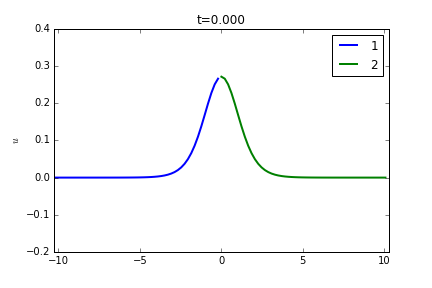
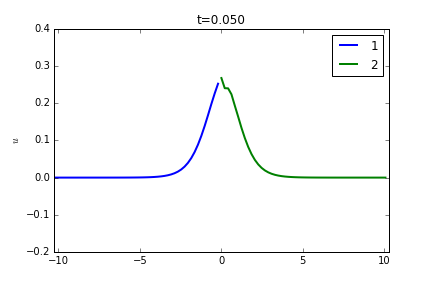
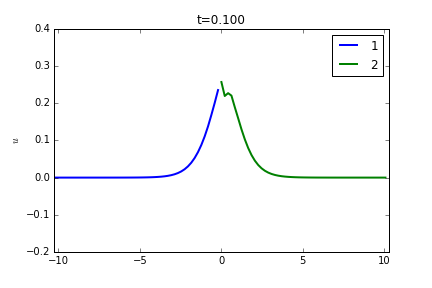
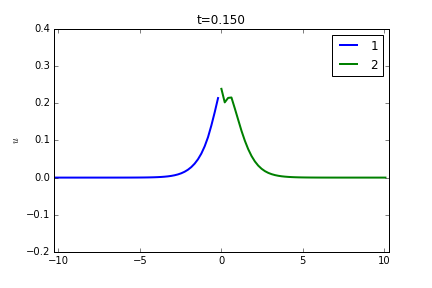
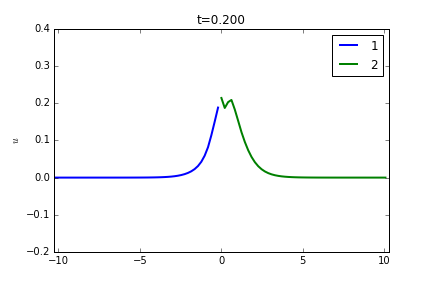
...
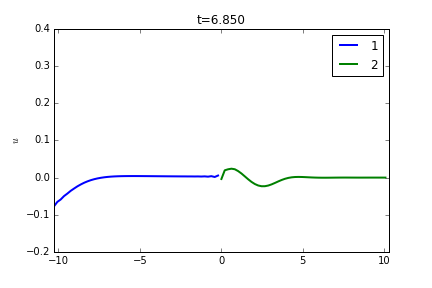
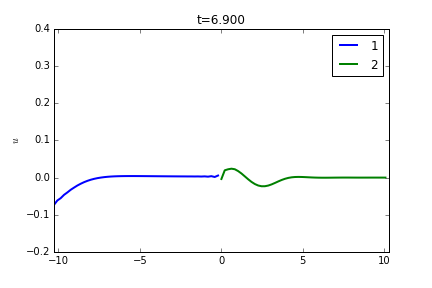
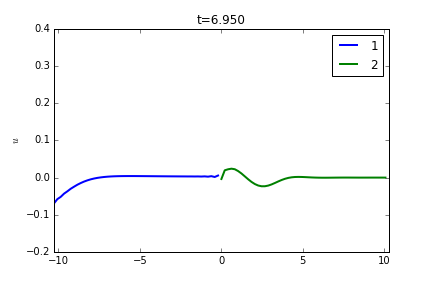
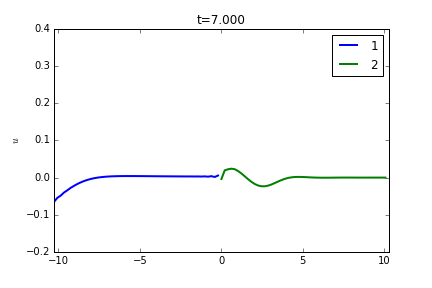
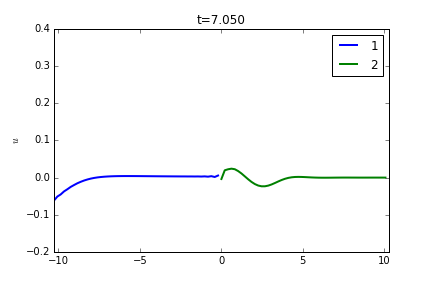

In [411]:
lb = ["1","2","M"]
gF.plotAnimationNSolutionsDiffDomain(2,np.array([x1P,x2P,xM]),np.array([uall1P,uall2P,uallM]),tall1,xmin,xmax,-0.2,0.4,lb,ylabel=r'$u$')

*** Plotting animation ...



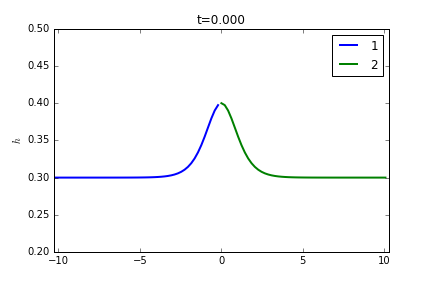
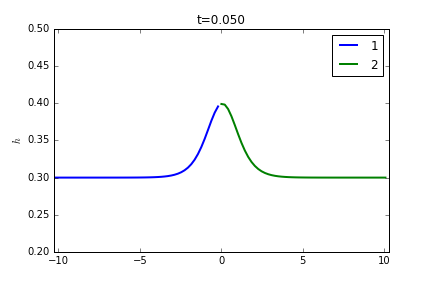
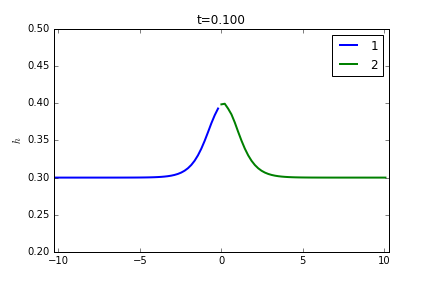
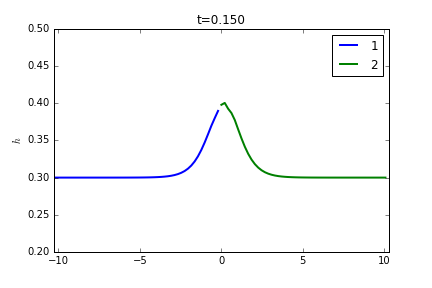
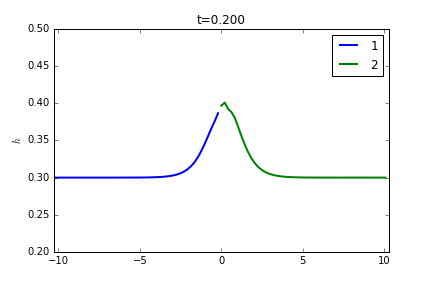
...
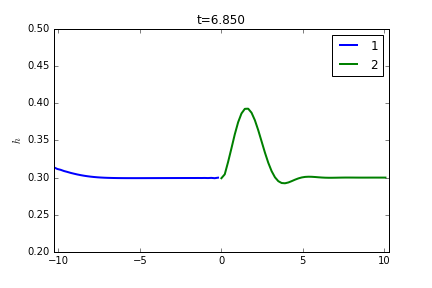
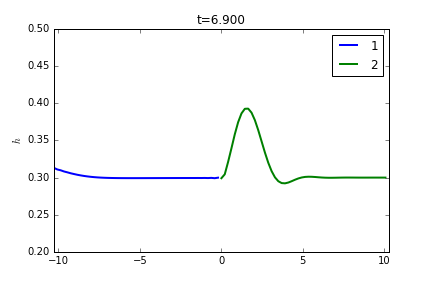
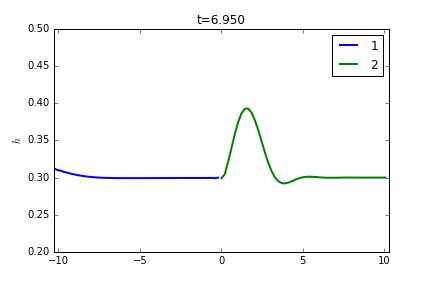
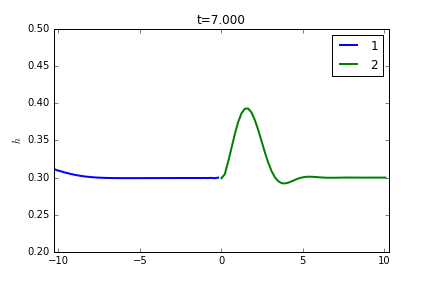
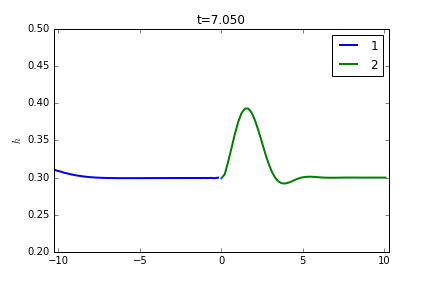

In [412]:
lb = ["1","2","M"]
gF.plotAnimationNSolutionsDiffDomain(2,np.array([x1P,x2P,xM]),np.array([hall1P,hall2P,hallM]),tall1,xmin,xmax,0.2,0.5,lb,ylabel=r'$h$')